In [54]:
# run_single_scale_detector.py

import cv2
import numpy as np

def run_single_scale_detector(classifier, test_images, scale_factor):
    detections = []
    for image_path in test_images:
        # Load the test image
        image = cv2.imread(image_path)
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        # Resize the image to a fixed size
        resized_image = cv2.resize(gray, (100, 100))

        # Detect faces using the classifier
        faces = classifier.detectMultiScale(resized_image, scaleFactor=scale_factor, minNeighbors=5)

        # Convert the coordinates to original image scale
        for (x, y, w, h) in faces:
            x *= (image.shape[1] / 100)
            y *= (image.shape[0] / 100)
            w *= (image.shape[1] / 100)
            h *= (image.shape[0] / 100)
            detections.append((x, y, w, h))

    return detections


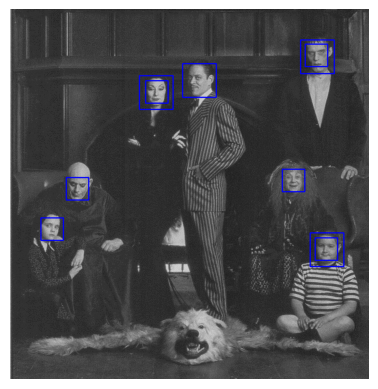

In [55]:
import cv2
import matplotlib.pyplot as plt

def run_single_scale_detector(classifier, test_images, scale_factor):
    detections = []
    for image_path in test_images:
        image = cv2.imread(image_path)
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        faces = classifier.detectMultiScale(gray, scaleFactor=scale_factor, minNeighbors=5)
        detections.extend(faces)
    return detections

def main():
    # Load the pre-trained classifier
    classifier = cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_default.xml")

    # Test images
    # test_images = ['/content/face_detection_test.jpg']
    test_images = [r'data/test_scenes/test_jpg/addams-family.jpg']

    # Run the single scale detector
    scale_factor = 1.5  # Adjust scale factor as needed
    detections = run_single_scale_detector(classifier, test_images, scale_factor)

    # Visualize the detections
    for image_path in test_images:
        image = cv2.imread(image_path)
        for (x, y, w, h) in detections:
            cv2.rectangle(image, (x, y), (x+w, y+h), (255, 0, 0), 2)

        # Convert image from BGR to RGB for displaying with matplotlib
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        plt.imshow(image_rgb)
        plt.axis('off')
        plt.show()

if __name__ == "__main__":
    main()



Creating the sliding window, multiscale detector is the most complex part of this project. A single scale detector which does not detect faces at multiple scales in each test image is provided for reference. Such a detector will not work nearly as well (perhaps 0.3 average precision) compared to the full multi-scale detector. With a well trained multi-scale detector with small step size you can expect an average precision above 0.9.


In [56]:
import numpy as np
import matplotlib.pyplot as plt

In [57]:
import numpy as np
import os
import random
from cyvlfeat.hog import hog
from skimage.io import imread
from tqdm import tqdm
from os import listdir
from os.path import isfile, join
import math
# you can implement your own data augmentation functions

def get_positive_features(train_path_pos, feature_params):
    """
    FUNC: This function should return all positive training examples (faces)
        from 36x36 images in 'train_path_pos'. Each face should be converted
        into a HoG template according to 'feature_params'. For improved performances,
        try mirroring or warping the positive training examples.
    ARG:
        - train_path_pos: a string; directory that contains 36x36 images
                          of faces.
        - feature_params: a dict; with keys,
                          > template_size: int (probably 36); the number of
                            pixels spanned by each train/test template.
                          > hog_cell_size: int (default 6); the number of pixels
                            in each HoG cell.
                          Template size should be evenly divisible by hog_cell_size.
                          Smaller HoG cell sizez tend to work better, but they
                          make things slower because the feature dimenionality
                          increases and more importantly the step size of the
                          classifier decreases at test time.
    RET:
        - features_pos: (N,D) ndarray; N is the number of faces and D is the
                        template dimensionality, which would be,
                        (template_size/hog_cell_size)^2 * 31,
                        if you're using default HoG parameters.
    """
    #########################################
    ##          you code here              ##
    #########################################
    image_files=[f for f in listdir(train_path_pos) if f.endswith('.jpg')]
    num_img=len(image_files)
    # for k, v in feature_params.items():
    #     print(k,v,feature_params[k])
    D=pow(feature_params['template_size']/feature_params['hog_cell_size'],2)*31
    D=int(D)
    # print(D)
    features_pos=np.zeros((num_img,D))
    for i in range(num_img):
        path=train_path_pos+'/'+image_files[i]
        # print(path)
        img=imread(path,cv2.IMREAD_GRAYSCALE)
        features_pos[i]=np.reshape(hog(img,feature_params['hog_cell_size']),(-1,))
    #########################################
    ##          you code here              ##
    #########################################
    # print(len(features_pos),len(features_pos[0]))
    return features_pos 

In [58]:
import numpy as np
import os
import random
from cyvlfeat.hog import hog
from skimage.io import imread
# from skimage.transform import pyramid_gaussian
from skimage import color
from tqdm import tqdm
from os import listdir
from os.path import isfile, join
import math
# you may implement your own data augmentation functions

def get_random_negative_features(non_face_scn_path, feature_params, num_samples):
    '''
    FUNC: This funciton should return negative training examples (non-faces) from
        any images in 'non_face_scn_path'. Images should be converted to grayscale,
        because the positive training data is only available in grayscale. For best
        performance, you should sample random negative examples at multiple scales.
    ARG:
        - non_face_scn_path: a string; directory contains many images which have no
                             faces in them.
        - feature_params: a dict; with keys,
                          > template_size: int (probably 36); the number of
                            pixels spanned by each train/test template.
                          > hog_cell_size: int (default 6); the number of pixels
                            in each HoG cell. 
                          Template size should be evenly divisible by hog_cell_size.
                          Smaller HoG cell sizez tend to work better, but they 
                          make things slower because the feature dimenionality 
                          increases and more importantly the step size of the 
                          classifier decreases at test time.
    RET:
        - features_neg: (N,D) ndarray; N is the number of non-faces and D is 
                        the template dimensionality, which would be, 
                        (template_size/hog_cell_size)^2 * 31,
                        if you're using default HoG parameters.
        - neg_examples: TODO
    '''
    #########################################
    ##          you code here              ##
    #########################################
    image_files=[f for f in listdir(non_face_scn_path) if f.endswith('.jpg')]
    num_img=len(image_files)
    # print(num_sample_per_img,num_samples/num_img)
    D=pow(feature_params['template_size']/feature_params['hog_cell_size'],2)*31
    # print(D)
    D=int(D)
    all_images=np.zeros([0, D])
    features_neg=np.zeros((num_samples,D))
    smp_per_img=math.ceil(num_samples/num_img)
    i=1
    # for j in range(num_img):
    #     path=non_face_scn_path+'/'+image_files[i]
    #     img=np.array(color.rgb2gray(imread(path))).astype('float32')
    #     height,width=len(img),len(img[0])
    #     # print(height,width,len(img),len(img[0]))
    #     for j in range(num_sample_per_img):
    #         top_left_x=math.floor(random.random()*(width-feat_size))
    #         top_left_y=math.floor(random.random()*(height-feat_size))
    #         index=i*num_sample_per_img+j
    #         print(index,num_img,num_sample_per_img,i,j)
    #         cropped=img[top_left_y:top_left_y+feat_size,top_left_x:top_left_x+feat_size]
    #         features_neg[index]=np.reshape(hog(cropped,feature_params['hog_cell_size']),(1,D))
    # neg_examples=len(features_neg)
    for j in range(num_img):
        path=non_face_scn_path+'/'+image_files[i]
        # all_images.append(np.array(imread(path)).astype('float32'))
        img=imread(path,cv2.IMREAD_GRAYSCALE)
        if min(len(img[0])-feature_params['template_size'],len(img)-feature_params['template_size'])<smp_per_img:
            num_sampd=min(len(img[0])-feature_params['template_size'],len(img)-feature_params['template_size'])
        else:
            num_sampd=smp_per_img
        # hogged=hog(all_images[j],feature_params['hog_cell_size'])
        # temp_height,temp_width=len(hogged),len(hogged[0])
        idx_i=np.random.choice(np.arange(len(img)-feature_params['template_size']),num_sampd,replace=False)
        idx_j=np.random.choice(np.arange(len(img[0])-feature_params['template_size']),num_sampd,replace=False)
        # for y in range(math.floor((temp_height-5)/freq)):
        #     for x in range(math.floor((temp_width-5)/freq)):
        #         xStart=x*freq
        #         yStart=y*freq
        #         xEnd=xStart+6
        #         yEnd=yStart+6
        #         frame=hogged[yStart:yEnd,xStart:xEnd]
        #         features_neg[i]=np.reshape(frame,(1,D))
        #         num_sampd+=1
        #         if i==num_samples:
        #             neg_examples=len(features_neg)
        #             return features_neg, neg_examples
        #         elif num_sampd>=num_samples/smp_per_img:
        #             break
        #     if num_sampd>=num_samples/smp_per_img:
        #         break
        # if num_sampd>=num_samples/smp_per_img:
        #     continue
        for x in range(num_sampd):
            portion=img[idx_i[x]:idx_i[x]+feature_params['template_size'],idx_j[x]:idx_j[x]+feature_params['template_size']]
            hogged=hog(portion, feature_params['hog_cell_size'])
            port=np.reshape(hogged,(1,-1))
            all_images = np.concatenate([all_images, port], axis=0)
    #########################################
    ##          you code here              ##
    #########################################
    neg_examples=len(features_neg)
    features_neg=all_images[np.random.choice(np.arange(len(all_images)), size=(num_samples), replace=False)]
    return features_neg, neg_examples


In [59]:
from sklearn import svm
import numpy as np
from sklearn.utils import column_or_1d
from sklearn.svm import LinearSVC
def svm_classify(x, y):
    '''
    FUNC: train SVM classifier with input data x and label y
    ARG:
        - x: input data, HOG features
        - y: label of x, face or non-face
    RET:
        - clf: a SVM classifier using sklearn.svm. (You can use your favorite
               SVM library but there will be some places to be modified in
               later-on prediction code)
    '''
    #########################################
    ##          you code here              ##
    #########################################
    clf = svm.LinearSVC(C=0.01)
    y =np.ravel(y)
    clf.fit(x, y) 
    #########################################
    ##          you code here              ##
    #########################################

    return clf

In [60]:
import numpy as np
import os
from skimage.io import imread
# from skimage.transform import resize
from skimage import color
from cyvlfeat.hog import hog


def run_detector(test_scn_path, model, feature_params):
    """
    FUNC: This function returns detections on all of the images in a given path.
        You will want to use non-maximum suppression on your detections or your
        performance will be poor (the evaluation counts a duplicate detection as
        wrong). The non-maximum suppression is done on a per-image basis. The
        starter code includes a call to a provided non-max suppression function.
    ARG:
        - test_scn_path: a string; This directory contains images which may or
                        may not have faces in them. This function should work for
                        the MIT+CMU test set but also for any other images.
        - model: the linear classifier model
        - feature_params: a dict; 'template_size': the number of pixels spanned
                        by each train / test template (probably 36).
                        'hog_cell_size': the number of pixels in each HoG cell
                        (default 6).
                        Template size should be evenly divisible by hog_cell_size.
                        Smaller HoG cell sizes tend to work better, but they make
                        things slower because the feature dimensionality increases
                        and more importantly the step size of the classifier
                        decreases at test time.
        - MORE...  You can add additional arguments for advanced work like multi-
                   scale, pixel shift and so on.
                   
    RET:
        - bboxes: (N, 4) ndarray; N is the number of non-overlapping detections, bboxes[i,:] is
                        [x_min, y_min, x_max, y_max] for detection i.
        - confidences: (N, 1) ndarray; confidences[i, :] is the real valued confidence
                        of detection i.
        - image_ids: (N, 1) ndarray;  image_ids[i, :] is the image file name for detection i.
    """
    # The placeholder version of this code will return random bounding boxes in
    # each test image. It will even do non-maximum suppression on the random
    # bounding boxes to give you an example of how to call the function.

    # Your actual code should convert each test image to HoG feature space with
    # a _single_ call to vl_hog for each scale. Then step over the HoG cells,
    # taking groups of cells that are the same size as your learned template,
    # and classifying them. If the classification is above some confidence,
    # keep the detection and then pass all the detections for an image to
    # non-maximum suppression. For your initial debugging, you can operate only
    # at a single scale and you can skip calling non-maximum suppression.

    test_images = os.listdir(test_scn_path)
    # print(test_images)
    # img_name=[f for f in test_images if f.endswith('.jpg')]
    # print(test_scn_path,img_name)
    # initialize these as empty and incrementally expand them.
    bboxes = np.zeros([0, 4])
    confidences = np.zeros([0, 1])
    image_ids = np.zeros([0, 1])

    cell_size = feature_params['hog_cell_size']
    cell_num = int(feature_params['template_size'] / feature_params['hog_cell_size'])  # cell number of each template

    for i in range(len(test_images)):

        #########################################
        ##          you code here              ##
        #########################################
        path=test_scn_path+'/'+test_images[i]
        # img=np.array(imread(path)).astype('float32')
        # dimension=len(img.shape)
        # print(dimension)
        # if dimension>2:
        #     img=color.rbg2gray(img)
        img=imread(path,cv2.IMREAD_GRAYSCALE)
        mindim=min(len(img),len(img[0]))
        count=1
        cur_bboxes=np.zeros([0,4])
        cur_image_ids=np.zeros([0,1])
        cur_confidences=np.zeros([0,1])
        while count*mindim>feature_params['template_size']:
            frame=cv2.resize(img,[int(len(img)*count),int(len(img[0])*count)])
            # print('82!!!!!!!!!!!!!!!!!!!!!!!!!!!!')
            hogged=hog(frame,cell_size)
            # print('84!!!!!!!!!!!')
            D=pow(cell_num,2)*31
            D=int(D)
            # print(len(hogged)-cell_size,len(hogged[0])-cell_size)
            for k in range(int(len(hogged)-cell_num+1)):
                for j in range(int(len(hogged[0])-cell_num+1)):
                    
                    curr_y_min=k
                    curr_x_min=j
                    mini_hog=hogged[curr_y_min:curr_y_min+cell_num,curr_x_min:curr_x_min+cell_num]
                    bfeat=np.reshape(mini_hog,(1,-1))
                    # score=model.predict(bfeat)
                    tmp_score=np.reshape(model.decision_function(bfeat),(1,-1))
                    if tmp_score[0,0]>0:
                        # hog_bbox=[curr_x_min,curr_y_min,curr_x_min+6,curr_y_min+6]
                        # cur_bboxes.append([h*cellsize for h in hog_bbox])
                        # cur_confidences.append(score)
                        # cur_image_ids.append(test_images[i])
                        # count+=1
                        rowS=int(j*cell_size/count)
                        rowE=int((j+cell_num)*cell_size/count)
                        colS=int(k*cell_size/count)
                        colE=int((k+cell_num)*cell_size/count)
                        cur_bboxes=np.concatenate([cur_bboxes,np.array([[rowS,colS,rowE,colE]])],axis=0)
                        cur_image_ids=np.concatenate([cur_image_ids,[[test_images[i]]]],axis=0)
                        cur_confidences=np.concatenate([cur_confidences,tmp_score],axis=0)
        # if count==1:
        #     continue
            count*=0.9
        #########################################
        ##          you code here              ##
        #########################################

        # non_max_supr_bbox can actually get somewhat slow with thousands of
        # initial detections. You could pre-filter the detections by confidence,
        # e.g. a detection with confidence -1.1 will probably never be
        # meaningful. You probably _don't_ want to threshold at 0.0, though. You
        # can get higher recall with a lower threshold. You don't need to modify
        # anything in non_max_supr_bbox, but you can.
        is_maximum = non_max_supr_bbox(cur_bboxes, cur_confidences, img.shape)

        cur_bboxes = cur_bboxes[is_maximum[:, 0], :]
        cur_confidences = cur_confidences[is_maximum[:, 0], :]
        cur_image_ids = cur_image_ids[is_maximum[:, 0]]

        bboxes = np.concatenate([bboxes, cur_bboxes], 0)
        confidences = np.concatenate([confidences, cur_confidences], 0)
        image_ids = np.concatenate([image_ids, cur_image_ids], 0)
    
    return bboxes, confidences, image_ids


In [61]:
import numpy as np

# import ipdb #DEBUG

def non_max_supr_bbox(bboxes, confidences, img_size, verbose=False):
    """
    FUNC: high confidence detections suppress all overlapping detections
        (including detections at other scales). Detections can partially
        overlap, but the center of one detection can not be within another
        detection.
    ARG:
        - bboxes: (N,4) ndarray; N is the number of non-overlapping detections,
                  and each row is [x_min, y_min, x_max, y_max].
        - confidences: (N,1) ndarray; Confidence of each detection after final
                  cascade node.
        - img_size: (2,) list; [y,x] of the image.
    RET:
        - is_valid_bbox: (N,1) bool ndarray; indicating valid bounding boxes.
    """

    # Truncate bounding boxes to image dimensions
    # print(bboxes,img_size[1])
    x_out_of_bounds = bboxes[:, 2] > img_size[1]  # xmax greater than x dimension
    y_out_of_bounds = bboxes[:, 3] > img_size[0]  # ymax greater than y dimension

    bboxes[x_out_of_bounds, 2] = img_size[1]
    bboxes[y_out_of_bounds, 3] = img_size[0]

    num_detections, _ = confidences.shape

    # higher confidence detections get priority
    ind = np.argsort(-confidences, axis=0).ravel()
    bboxes = bboxes[ind, :]

    # indicator for whether each bbox will be accepted or suppressed
    is_valid_bbox = np.zeros((num_detections, 1), dtype=np.bool)
    for i in range(num_detections):
        cur_bb = bboxes[i, :]
        cur_bb_is_valid = True

        for j in np.where(is_valid_bbox)[0]:
            prev_bb = bboxes[j, :]
            bi = [max(cur_bb[0], prev_bb[0]),
                  max(cur_bb[1], prev_bb[1]),
                  min(cur_bb[2], prev_bb[2]),
                  min(cur_bb[3], prev_bb[3])]
            iw = bi[2] - bi[0] + 1
            ih = bi[3] - bi[1] + 1
            if iw > 0 and ih > 0:
                # compute overlap as area of intersection / area of union
                ua = (cur_bb[2] - cur_bb[0] + 1) * (cur_bb[3] - cur_bb[1] + 1) + \
                     (prev_bb[2] - prev_bb[0] + 1) * (prev_bb[3] - prev_bb[1] + 1) - \
                     iw * ih
                ov = iw * ih / ua
                # if the less confident detection overlaps too much with the previous detection
                if ov > 0.4:
                    cur_bb_is_valid = False

                center_coord = [(cur_bb[0] + cur_bb[2]) / 2, (cur_bb[1] + cur_bb[3]) / 2]
                if (center_coord[0] > prev_bb[0]) and (center_coord[0] < prev_bb[2]) and \
                        (center_coord[1] > prev_bb[1]) and (center_coord[1] < prev_bb[3]):
                    cur_bb_is_valid = False

                if verbose:
                    print('detection {}, bbox: [{},{},{},{}], {} overlap with {} [{},{},{},{}]'.format( \
                        i, cur_bb[0], cur_bb[1], cur_bb[2], cur_bb[3], ov, j, prev_bb[0], prev_bb[1], \
                        prev_bb[2], prev_bb[3]))

        is_valid_bbox[i] = cur_bb_is_valid

    # This statement returns the logical array 'is_valid_bbox' back to the order
    # of the input bboxes and confidences
    reverse_map = np.zeros((num_detections,), dtype=np.int)
    reverse_map[ind] = np.arange(num_detections)
    is_valid_bbox = is_valid_bbox[reverse_map, :]

    return is_valid_bbox

In [62]:
def VOCap(rec, prec):
    mrec = np.concatenate(([0.], rec, [1.]))
    mpre = np.concatenate(([0.], prec, [0.]))

    # compute the precision envelope
    for i in range(mpre.size - 1, 0, -1):
        mpre[i - 1] = np.maximum(mpre[i - 1], mpre[i])

    # to calculate area under PR curve, look for points
    # where X axis (recall) changes value
    i = np.where(mrec[1:] != mrec[:-1])[0]

    # and sum (\Delta recall) * prec
    ap = np.sum((mrec[i + 1] - mrec[i]) * mpre[i + 1])

    return ap

In [63]:
import numpy as np

# DO NOT MODIFY EVALUATION CODE
def report_accuracy(confidences, label_vector):
    confidences = confidences.ravel()
    label_vector = label_vector.ravel()
    assert confidences.size==label_vector.size, "Size of confidences and label_vector should be the same"
    # compute accuracy
    accuracy = ((label_vector*confidences)>0).sum() / float(confidences.size)
    print("  accuracy: {:.3f}".format(accuracy))

    # compute true positive rate (TP)
    true_positives = np.logical_and((confidences>=0), (label_vector>=0))
    tpr = true_positives.sum() / float(true_positives.size)
    print("  true positive rate: {:.3f}".format(tpr))

    # compute false positive rate (FP)
    false_positives = np.logical_and((confidences>=0), (label_vector<0))
    fpr = false_positives.sum() / float(false_positives.size)
    print("  false positive rate: {:.3f}".format(fpr))

    # compute true negative rate (TN)
    true_negatives = np.logical_and((confidences<0), (label_vector<0))
    tnr = true_negatives.sum() / float(true_negatives.size)
    print("  true negative rate: {:.3f}".format(tnr))

    # compute false negative rate (FN)
    false_negatives = np.logical_and((confidences<0), (label_vector>=0))
    fnr = false_negatives.sum() / float(false_negatives.size)
    print("  false negative rate: {:.3f}".format(fnr))

    return tpr, fpr, tnr, fnr

In [64]:
import numpy as np
from time import time
from matplotlib import pyplot as plt

# DO NOT MODIFY EVALUATION CODE!!!!
def evaluate_detections(bboxes, confidences, image_ids, label_path, fig_path, draw=True):
    """
    FUNC: This function will calculate the result by Pascal VOC Evaluation
    ARG:
        - bboxes: (N, 4) ndarray; N is the number of non-overlapping detections, bboxes[i,:] is
                        [x_min, y_min, x_max, y_max] for detection i.
        - confidences: (N, 1) ndarray; confidences[i] is the real valued confidence
                        of detection i.
        - image_ids: a list;  image_ids[i] is the image file name for detection i.
        - label_path: a string; the path of the file with ground truth bounding boxes for the test set
    """
    # This code is modified from the 2010 Pascal VOC toolkit.
    # http: // pascallin.ecs.soton.ac.uk / challenges / VOC / voc2010 / index.html  # devkit


    f = open(label_path, 'r')
    lines = f.readlines()
    gt_ids = []
    gt_bboxes = np.zeros([len(lines), 4])
    for i in range(len(lines)):
        gt_info = lines[i].rstrip('\r\n').split()
        gt_ids.append(gt_info[0])
        gt_bboxes[i, :] = [float(x) for x in gt_info[1:]]
    f.close()

    gt_isclaimed = np.zeros([len(gt_ids), 1])
    npos = len(gt_ids)  # total number of true positives.

    # sort detections by decreasing confidence
    si = np.squeeze(np.argsort(-confidences, axis=0))
    image_ids = image_ids[si]
    bboxes = bboxes[si]

    # assign detections to ground truth objects
    nd = len(confidences)
    tp = np.zeros([nd, 1])
    fp = np.zeros([nd, 1])
    duplicate_detections = np.zeros([nd, 1])

    t = time()
    for d in range(nd):
        # display progress
        if (time() - t) > 1:
            print ('pr: compute: {}/{}\n'.format(d, nd))
            t = time()

        cur_gt_ids = [i for i, gt_id in enumerate(gt_ids) if image_ids[d] == gt_id]

        bb = bboxes[d, :]
        ovmax = -np.inf

        for j in cur_gt_ids:
            bbgt = gt_bboxes[j, :]
            bi = [max(bb[0], bbgt[0]), max(bb[1], bbgt[1]), min(bb[2], bbgt[2]), min(bb[3], bbgt[3])]
            iw = bi[2] - bi[0] + 1
            ih = bi[3] - bi[1] + 1
            if iw > 0 and ih > 0:
                # compute overlap as area of intersection / area of union
                ua = (bb[2] - bb[0] + 1) * (bb[3] - bb[1] + 1) + \
                     (bbgt[2] - bbgt[0] + 1) * (bbgt[3] - bbgt[1] + 1) - iw * ih
                ov = iw * ih / ua
                if ov > ovmax:  # higher overlap than the previous best?
                    ovmax = ov
                    jmax = j

        # assign detection as true positive / don 't care/false positive
        if ovmax >= 0.3:
            if not gt_isclaimed[jmax]:
                tp[d] = 1  # true positive
                gt_isclaimed[jmax] = True
            else:
                fp[d] = 1  # false positive (multiple detection)
                duplicate_detections[d] = 1
        else:
            fp[d] = 1  # false positive

    # compute cumulative precision / recall
    cum_fp = np.cumsum(fp)
    cum_tp = np.cumsum(tp)
    rec = cum_tp / npos
    prec = np.divide(cum_tp, (cum_fp + cum_tp))

    ap = VOCap(rec, prec)

    if draw:
        # plot precision / recall
        fig12 = plt.figure(12)
        line = plt.plot(rec, prec, '-')
        plt.axis([0, 1, 0, 1])
        plt.grid()
        plt.xlabel('recall')
        plt.ylabel('precision')
        plt.title('Average Precision = {:0.2f}'.format(ap))
        plt.setp(line, 'color', 'blue')

        plt.pause(0.1)  # let's ui rendering catch up
        fig12.savefig('{}/average_precision.png'.format(fig_path))

        plt.figure(13)
        plt.plot(cum_fp, rec, '-')
        plt.axis([0, 300, 0, 1])
        plt.grid()
        plt.xlabel('False positives')
        plt.ylabel('Number of correct detections (recall)')
        plt.title('This plot is meant to match Figure 6 in Viola Jones')

    # # Re-sort return variables so that they are in the order of the input bboxes
    reverse_map = np.zeros([nd], dtype=np.int)
    reverse_map[si] = range(nd)
    tp = tp[reverse_map]
    fp = fp[reverse_map]
    duplicate_detections = duplicate_detections[reverse_map]

    return gt_ids, gt_bboxes, gt_isclaimed, tp, fp, duplicate_detections

In [65]:
import numpy as np
import os
from skimage.io import imread
from matplotlib import pyplot as plt


def visualize_detections_by_image(bboxes, confidences, image_ids, tp, fp, test_scn_path, label_path, fig_path):
    """
    FUNC: This function will calculate the result by Pascal VOC Evaluation
    ARG:
        - bboxes: (N, 4) ndarray; N is the number of non-overlapping detections, bboxes[i, :] is
                        [x_min, y_min, x_max, y_max] for detection i.
        - confidences: (N, 1) ndarray; confidences[i, :] is the real valued confidence
                        of detection i.
        - image_ids: (N, 1) ndarray;  image_ids[i, :] is the image file name for detection i.
        - label_path: a string; the path of the file with ground truth bounding boxes for the test set
    """

    # This code is modified from the 2010 Pascal VOC toolkit.
    # http: // pascallin.ecs.soton.ac.uk / challenges / VOC / voc2010 / index.html  # devkit
    # This function visualizes all detections in each test image

    f = open(label_path, 'r')
    lines = f.readlines()
    gt_ids = []
    gt_bboxes = np.zeros([len(lines), 4])
    for i in range(len(lines)):
        gt_info = lines[i].rstrip('\r\n').split()
        gt_ids.append(gt_info[0])
        gt_bboxes[i, :] = [float(x) for x in gt_info[1:]]
    f.close()

    gt_file_list = np.unique(gt_ids)
    test_image_list = np.unique(image_ids)

    num_test_images = len(gt_file_list)

    for cur_image_id in test_image_list:

        cur_test_image = imread(os.path.join(test_scn_path, cur_image_id))
        cur_test_image = np.tile(np.expand_dims(cur_test_image, 2), [1, 1, 3])
        cur_gt_detections = [ids for ids, gt_id in enumerate(gt_ids) if cur_image_id == gt_id]
        cur_gt_bboxes = gt_bboxes[cur_gt_detections, :]

        cur_detections = [idx for idx, image_id in enumerate(image_ids) if cur_image_id == image_id[0]]
        cur_bboxes = bboxes[cur_detections, :]
        cur_confidences = confidences[cur_detections]
        cur_tp = tp[cur_detections]
        cur_fp = fp[cur_detections]

        fig15 = plt.figure(15)
        plt.imshow(cur_test_image)
        # plt.hold(True)

        num_detections = len(cur_detections)
        x_pos = [0, 2, 2, 0, 0]
        y_pos = [1, 1, 3, 3, 1]

        for j in range(num_detections):
            bb = cur_bboxes[j, :]
            if cur_tp[j]:  # this was a correct detection
                plt.plot(bb[x_pos], bb[y_pos], color='g', linewidth=2, linestyle=':')
            elif cur_fp[j]:
                plt.plot(bb[x_pos], bb[y_pos], color='r', linewidth=2)
            else:
                ValueError('a detection was neither a true positive or a false positive')

        num_gt_bboxes = len(cur_gt_bboxes)

        for j in range(num_gt_bboxes):
            bbgt = cur_gt_bboxes[j, :]
            plt.plot(bbgt[x_pos], bbgt[y_pos], color='y', linewidth=2, linestyle='--')

        # plt.hold(False)
        plt.axis('image')
        plt.axis('off')
        plt.title('image: "{}" (green=true pos, red=false pos,\nyellow=ground truth), {}/{} found'.format(
            cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))

        # plt.setp(line, 'color', 'blue')

        plt.pause(0.1)  # let's ui rendering catch up
        fig15.savefig('{}/detections_{}'.format(fig_path, cur_image_id))

        #raw_input('press any key to continue with next image\n')

/home/tarunteja/Desktop/CN/x/.conda/lib/python3.8/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(


Initial classifier performance on train data:
  accuracy: 0.997
  true positive rate: 0.399
  false positive rate: 0.000
  true negative rate: 0.598
  false negative rate: 0.003


/tmp/ipykernel_2867/166839571.py:36: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  is_valid_bbox = np.zeros((num_detections, 1), dtype=np.bool)
/tmp/ipykernel_2867/166839571.py:73: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  

pr: compute: 1654/7190

pr: compute: 3378/7190

pr: compute: 5062/7190

pr: compute: 6738/7190



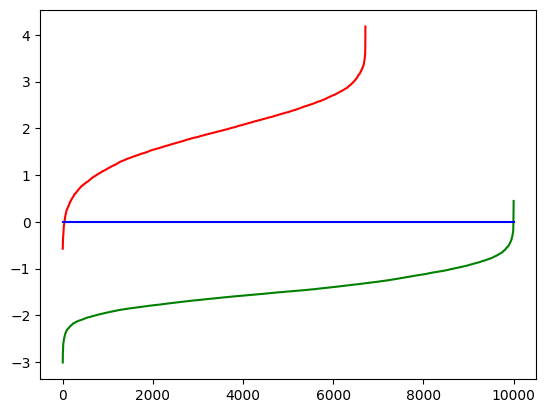

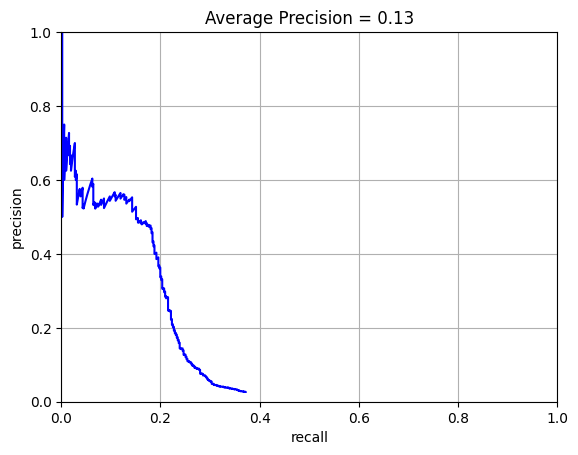

/tmp/ipykernel_2867/1689432107.py:113: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  reverse_map = np.zeros([nd], dtype=np.int)
/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in Nu

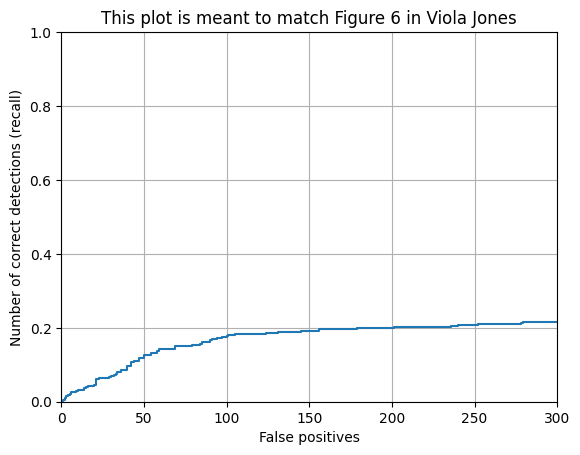

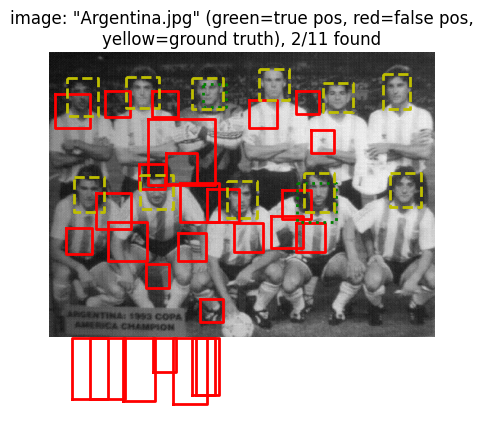

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


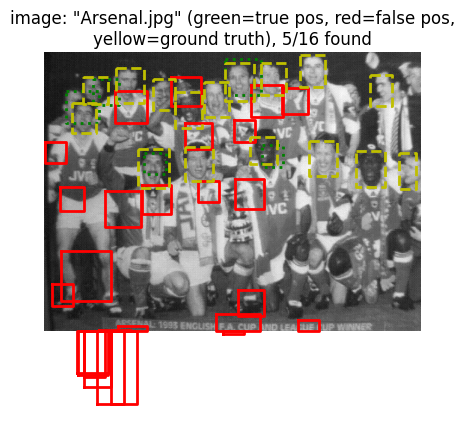

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


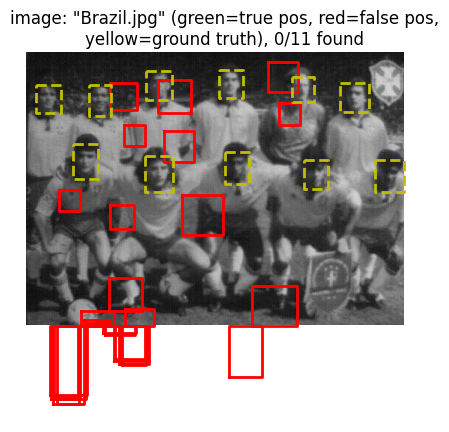

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


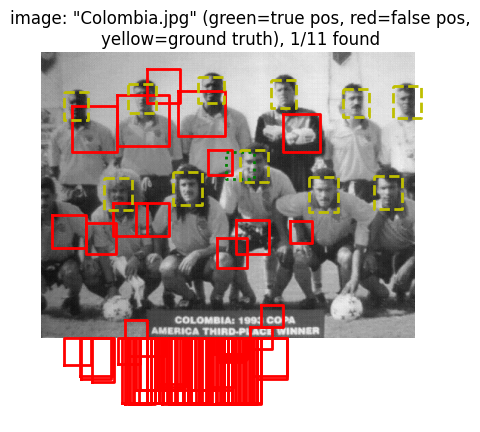

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


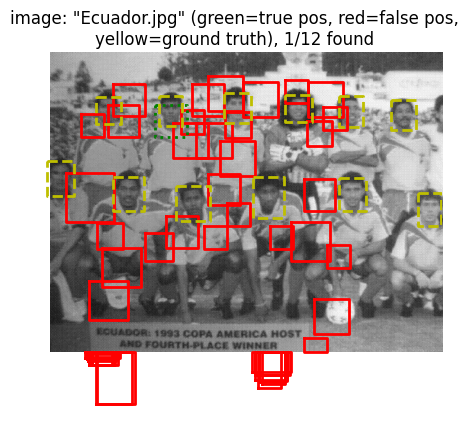

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


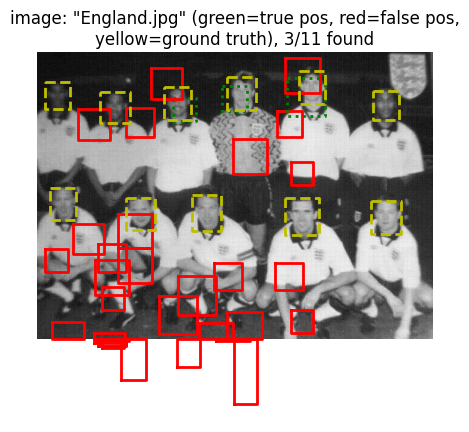

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


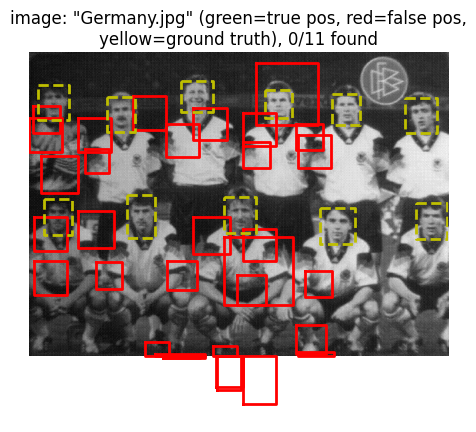

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


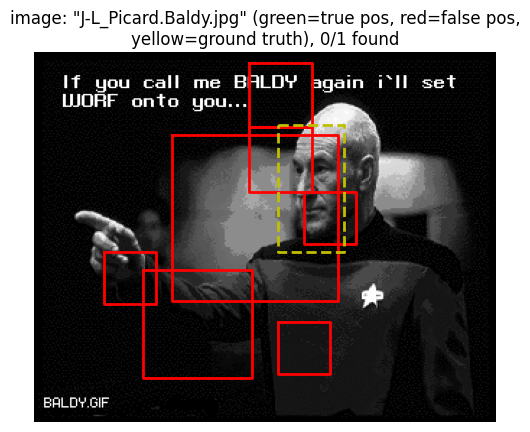

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


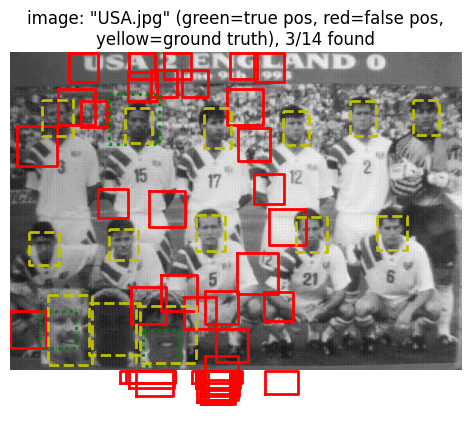

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


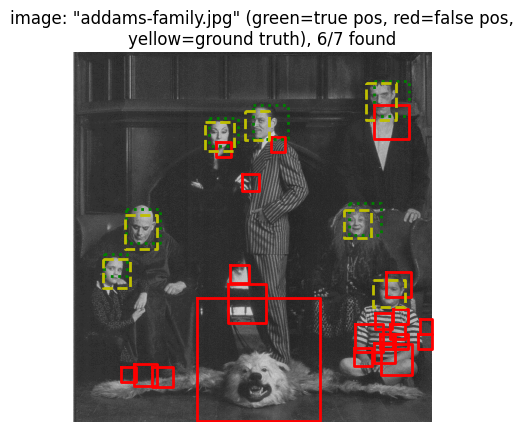

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


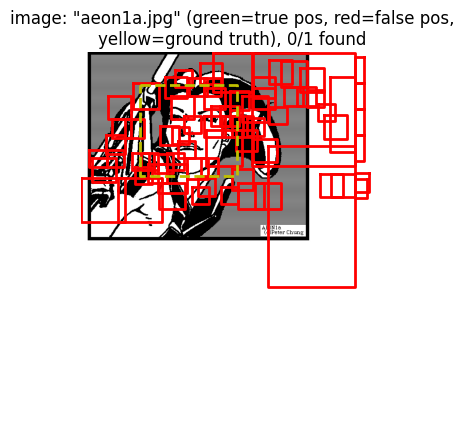

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


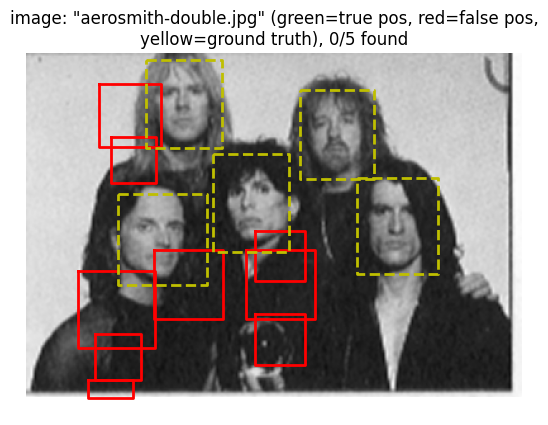

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


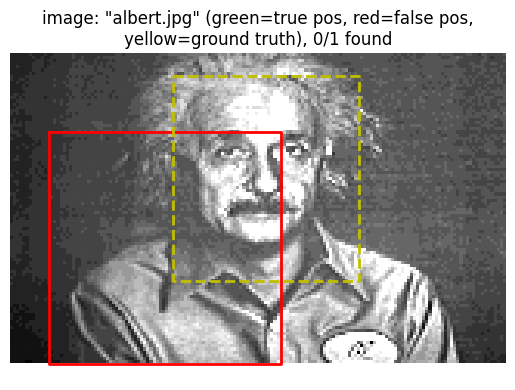

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


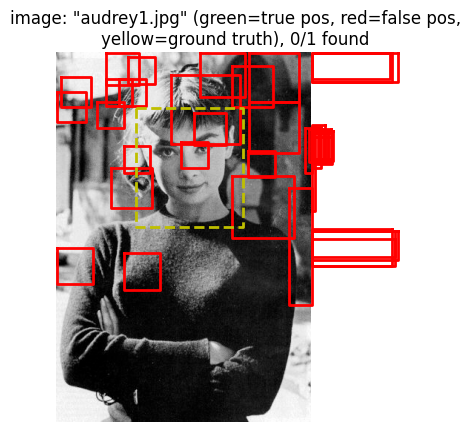

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


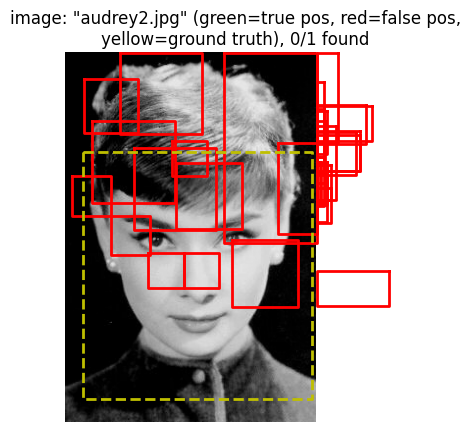

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


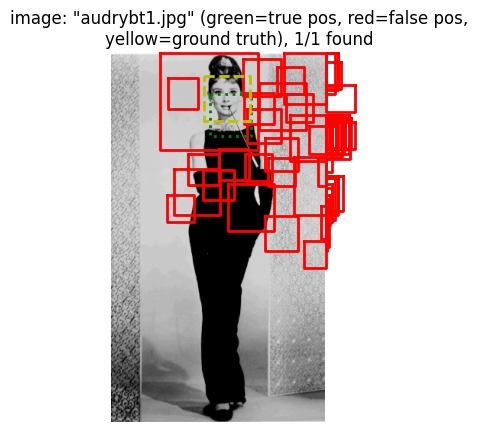

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


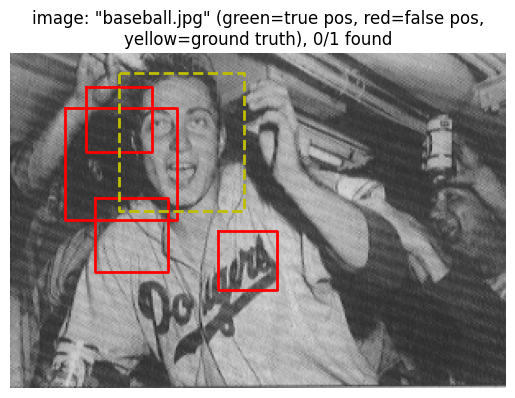

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


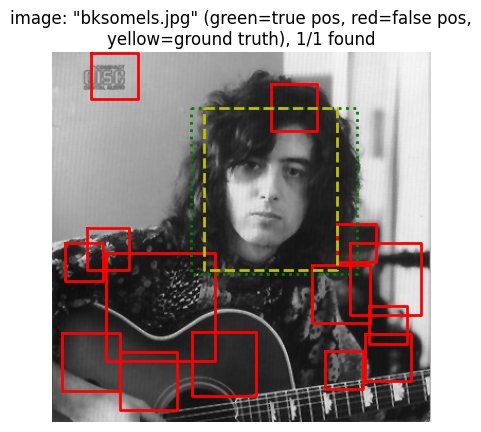

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


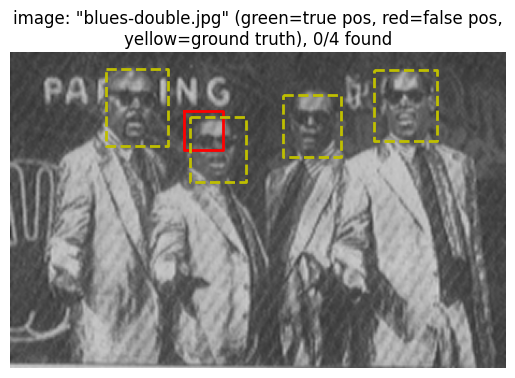

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


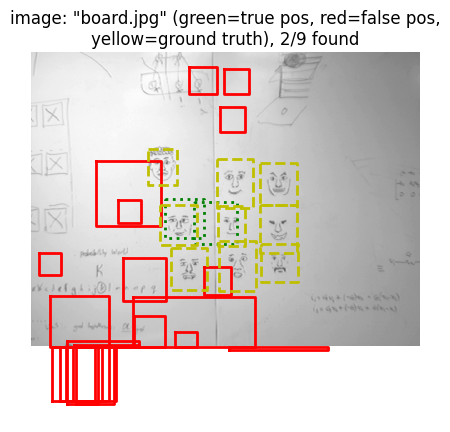

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


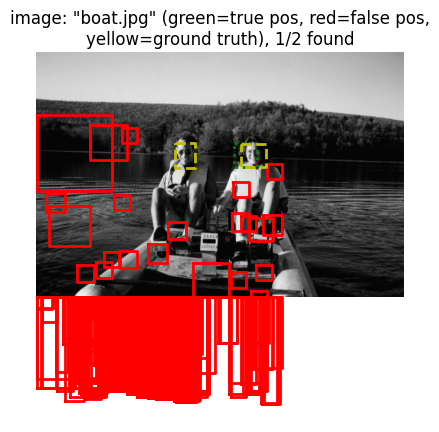

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


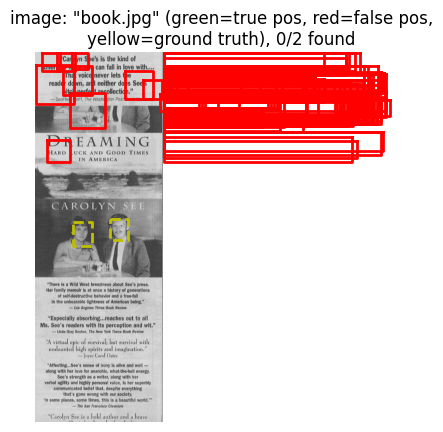

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


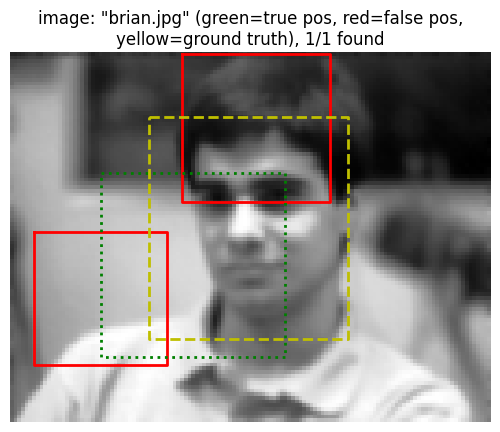

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


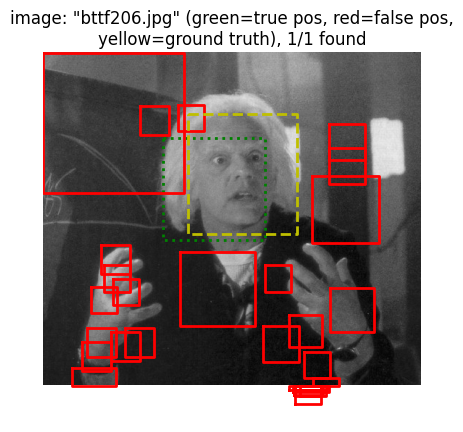

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


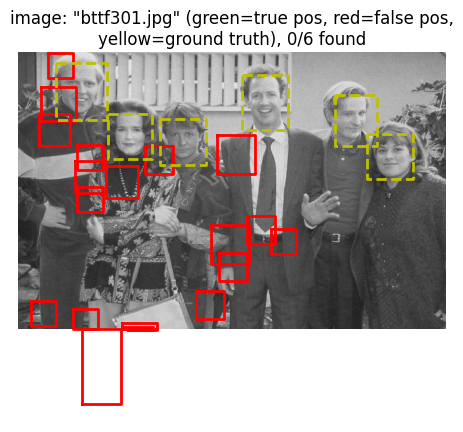

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


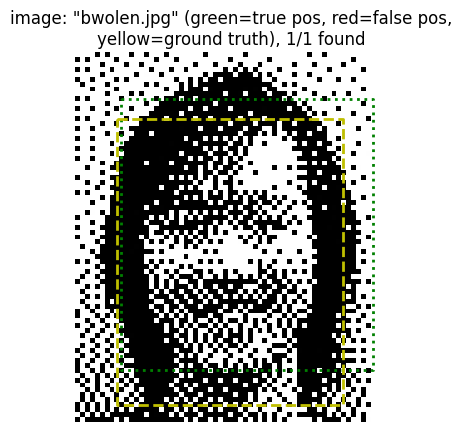

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


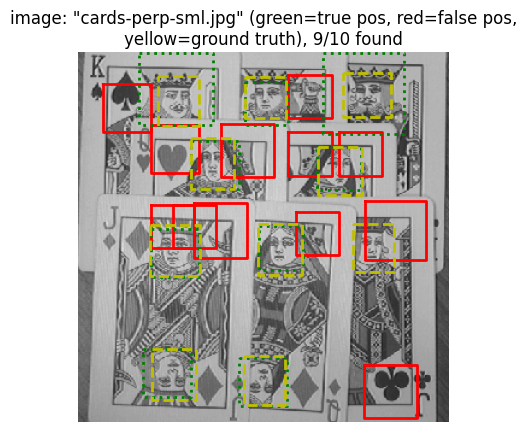

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


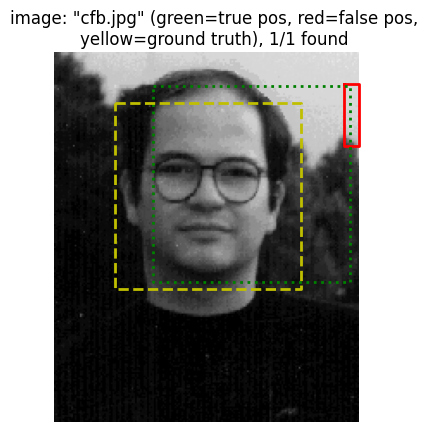

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


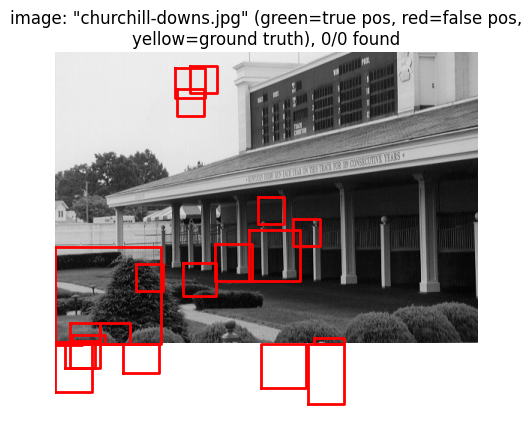

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


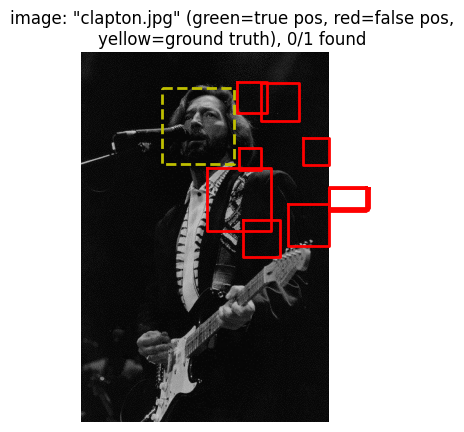

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


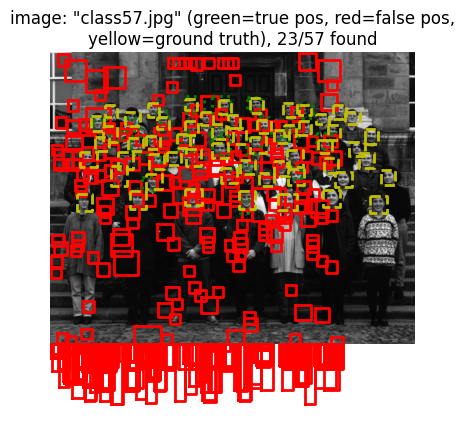

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


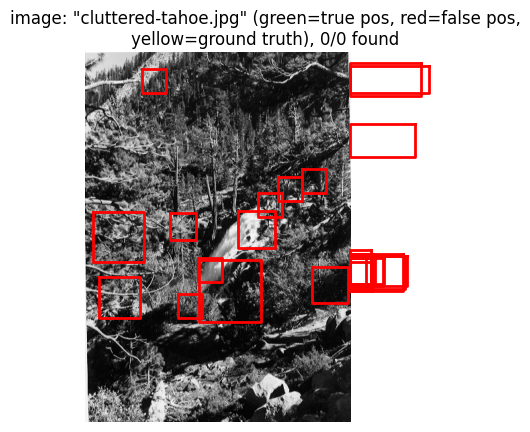

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


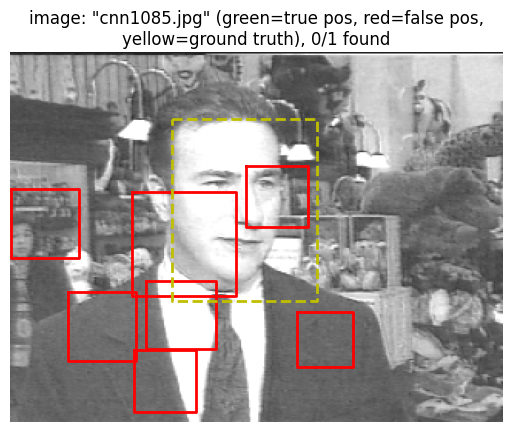

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


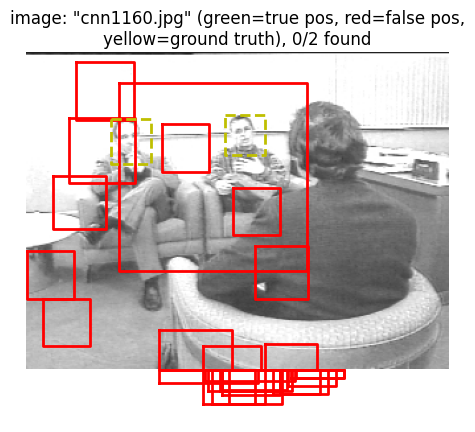

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


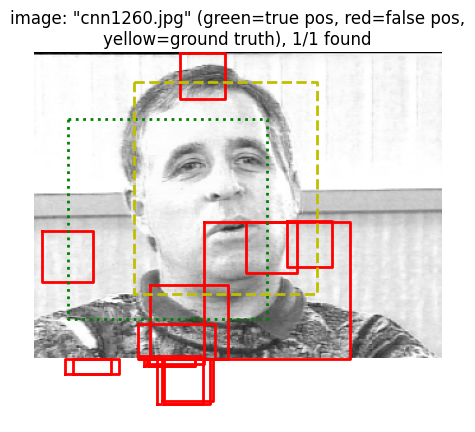

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


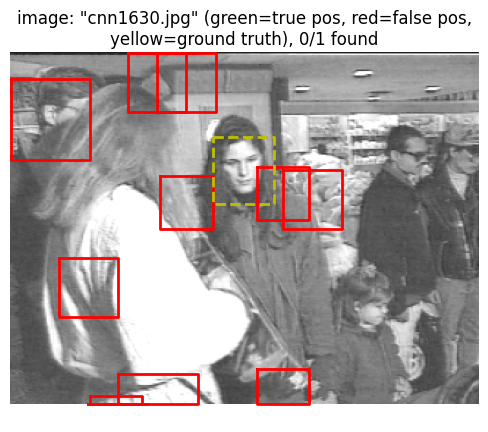

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


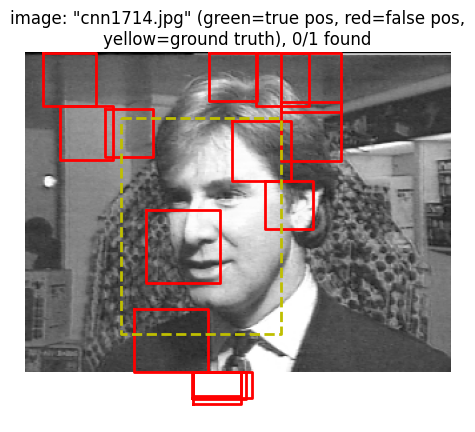

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


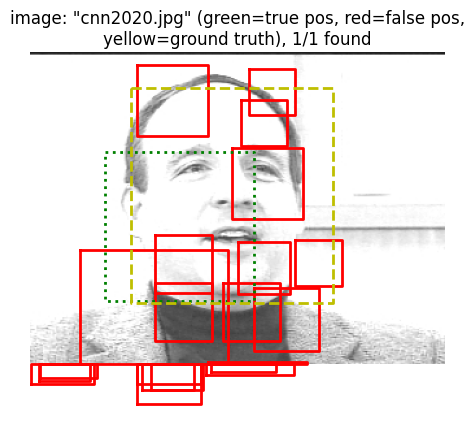

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


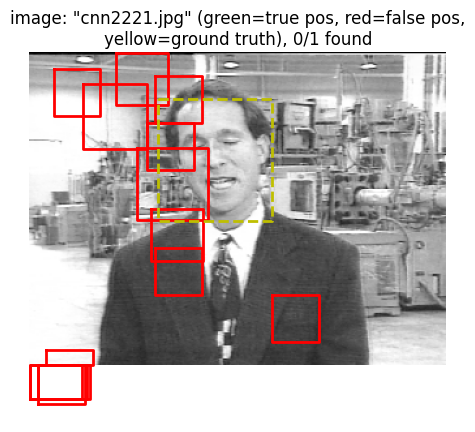

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


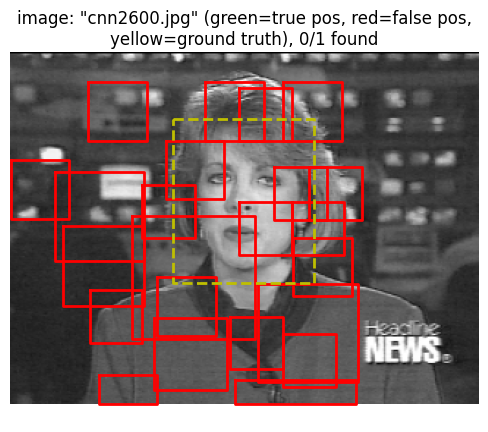

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


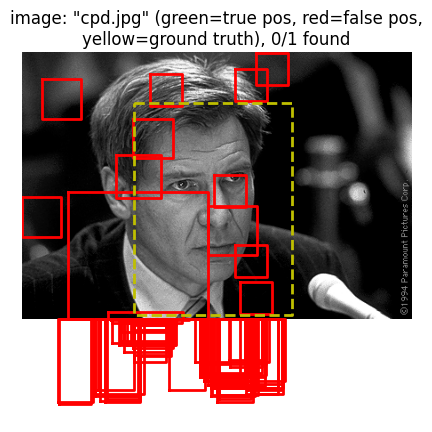

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


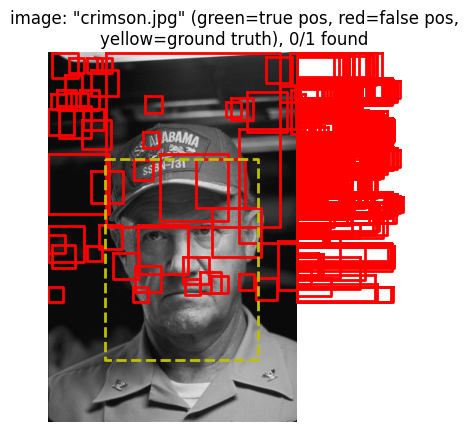

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


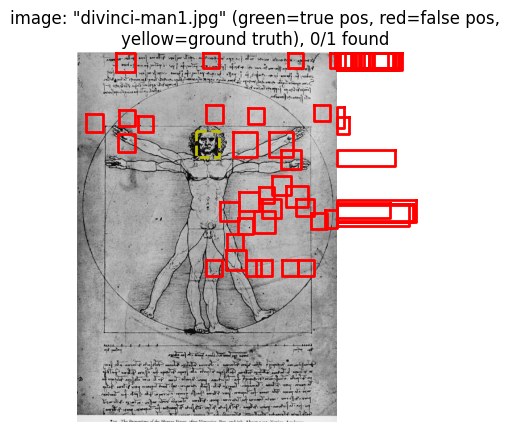

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


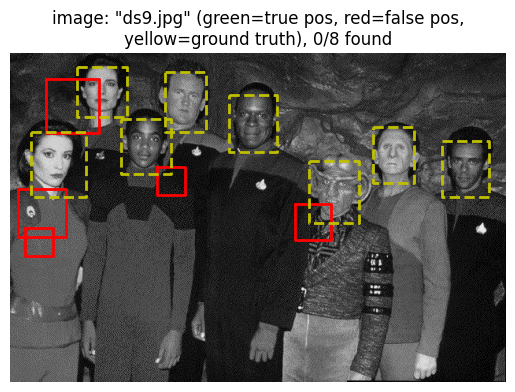

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


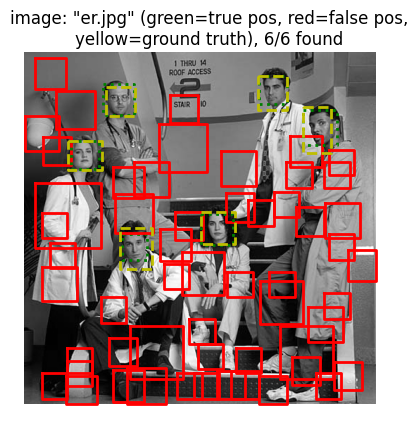

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


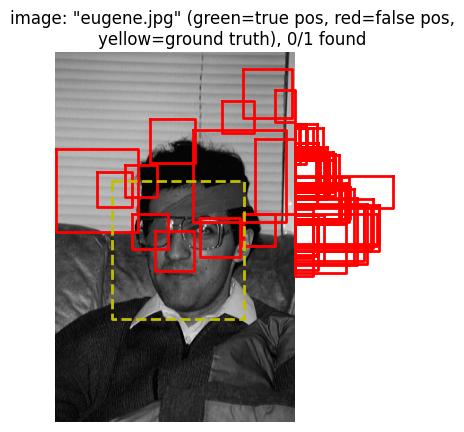

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


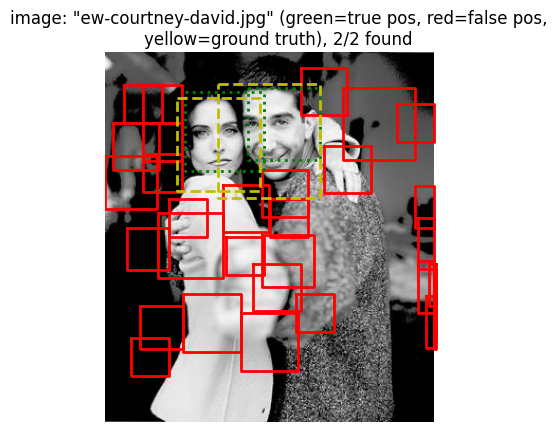

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


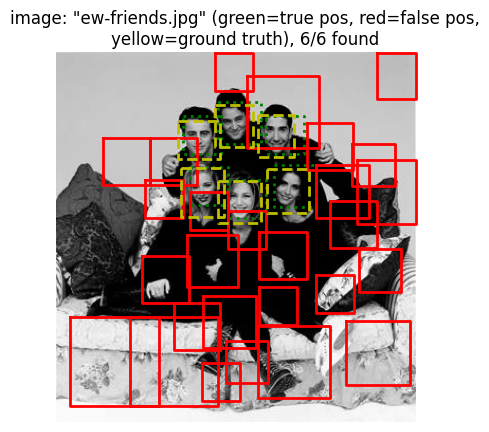

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


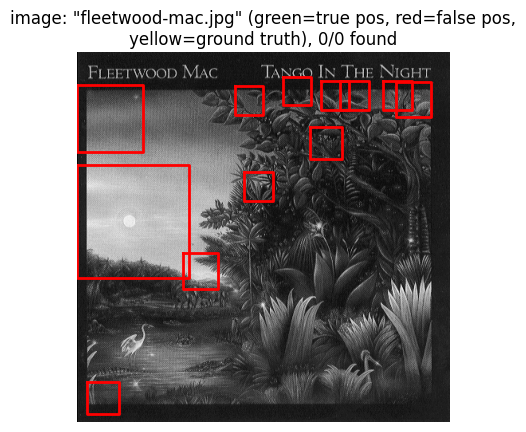

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


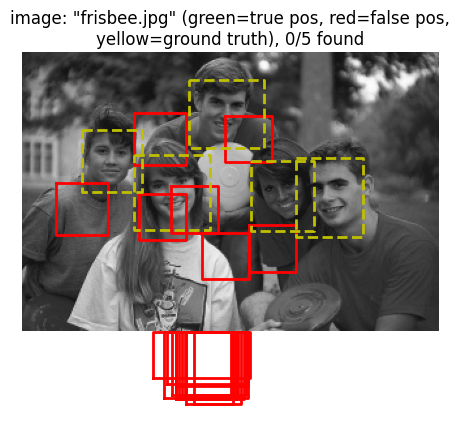

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


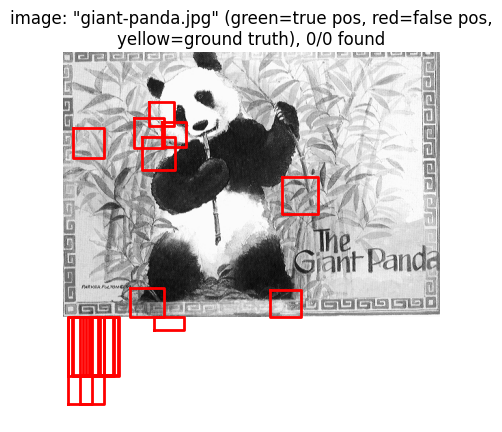

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


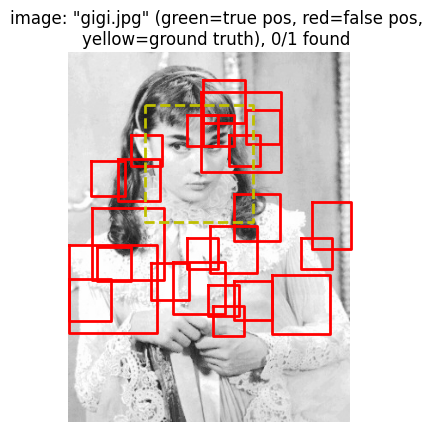

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


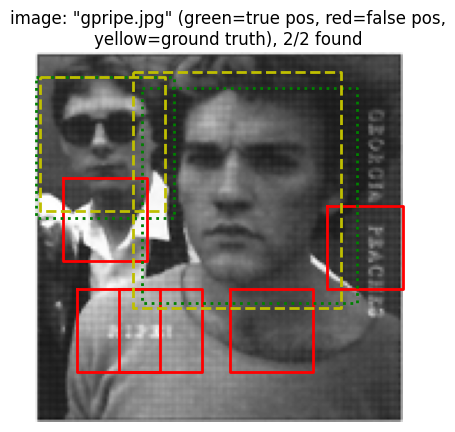

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


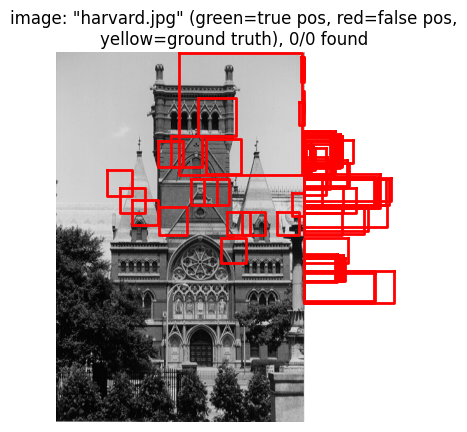

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


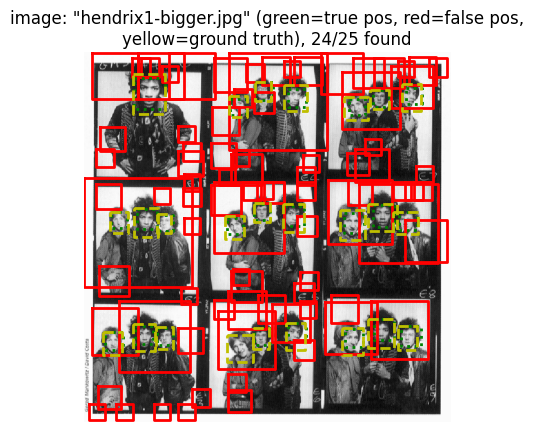

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


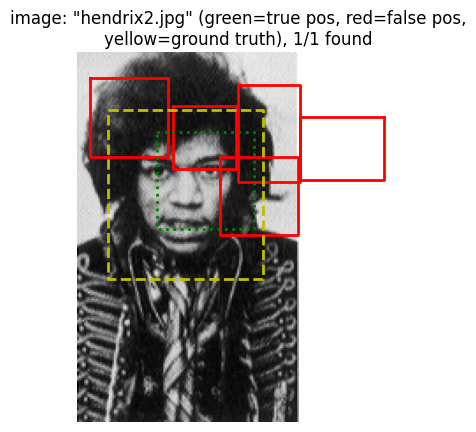

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


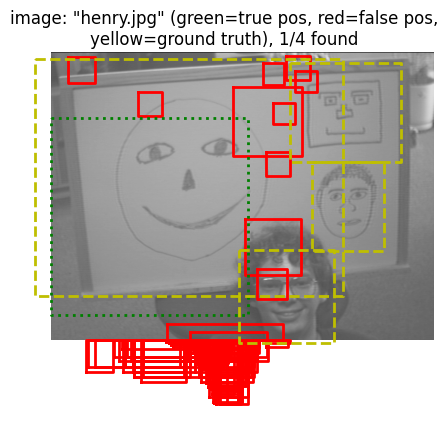

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


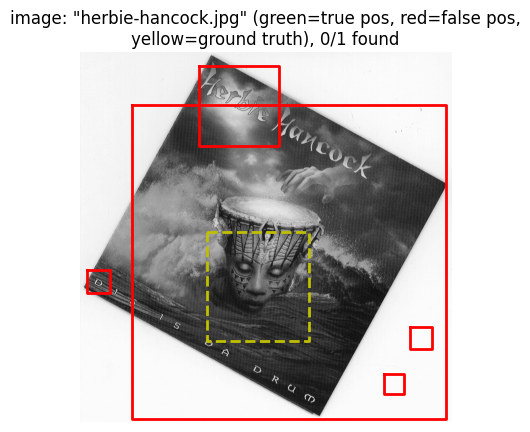

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


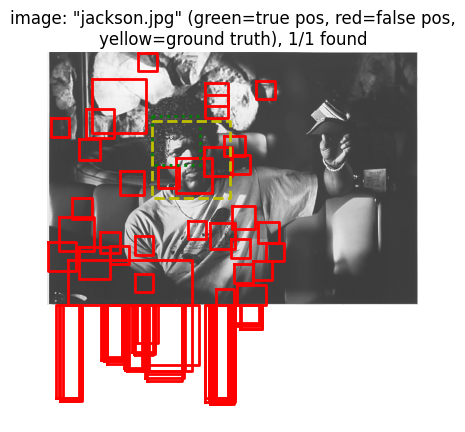

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


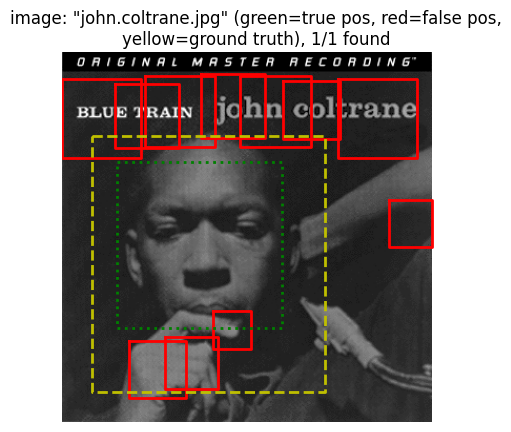

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


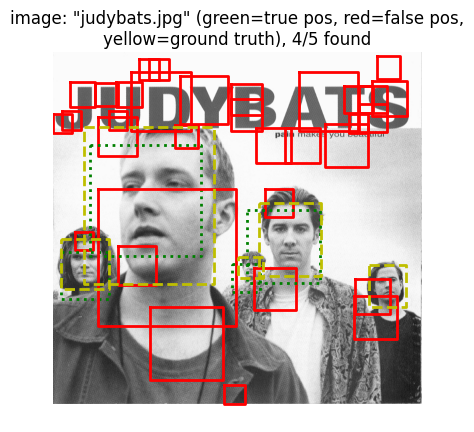

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


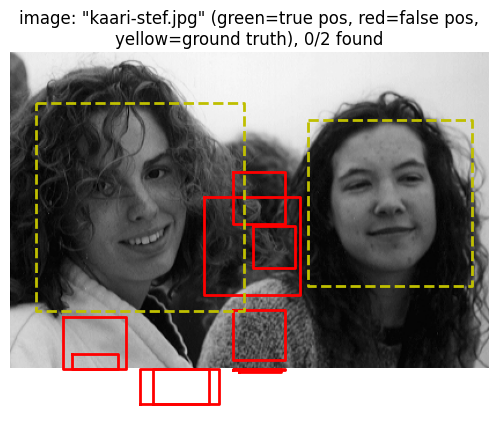

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


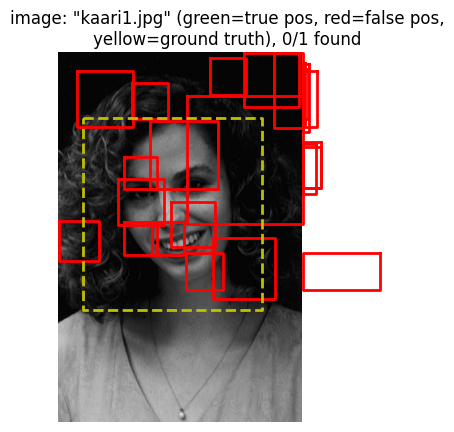

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


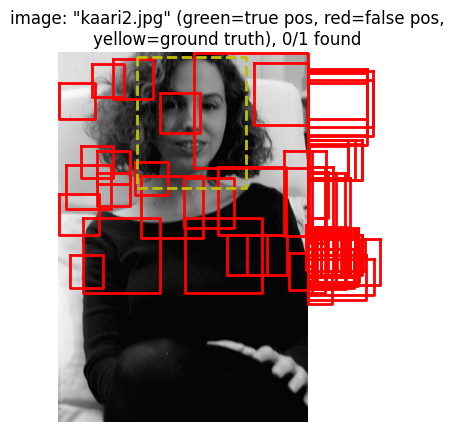

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


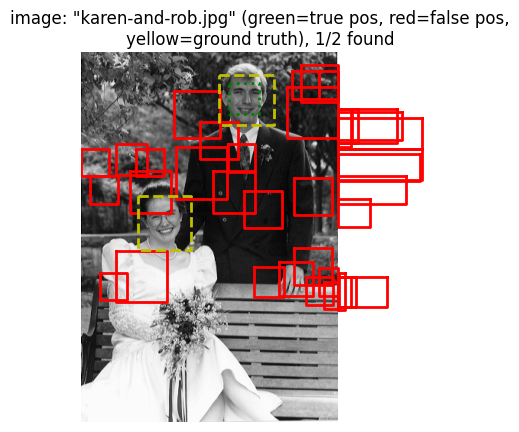

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


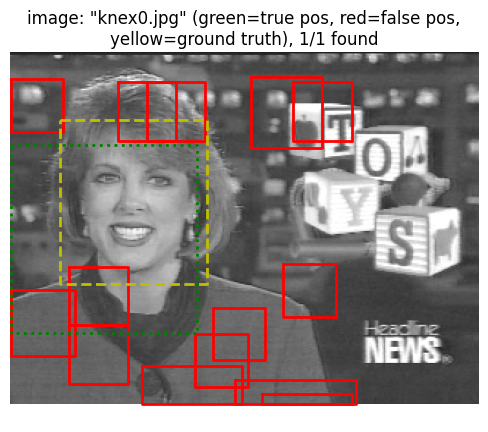

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


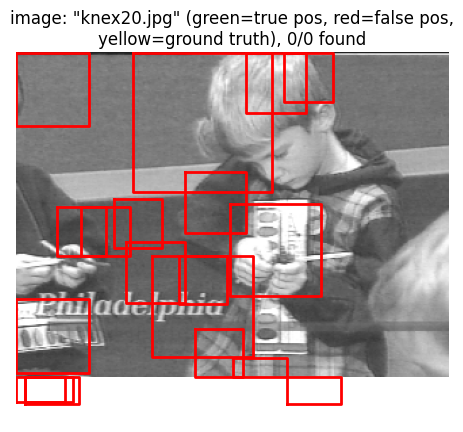

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


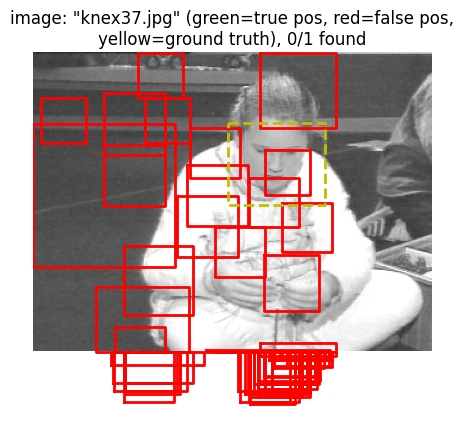

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


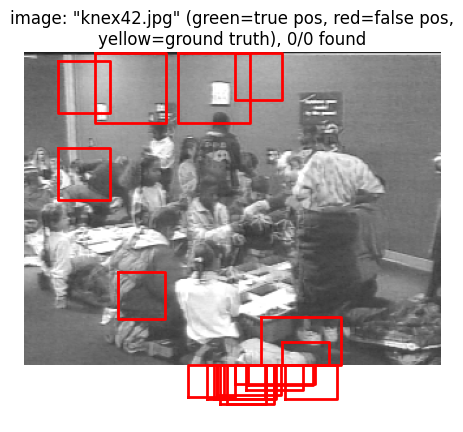

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


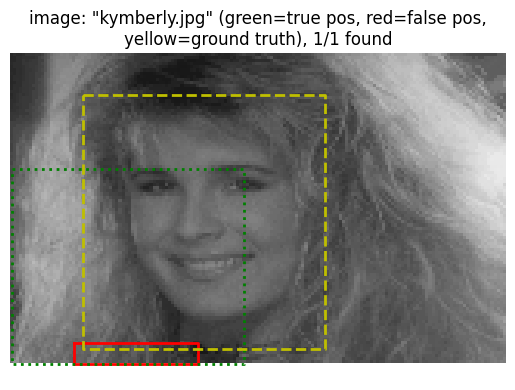

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


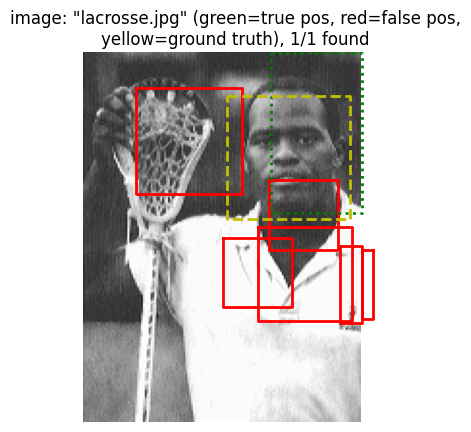

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


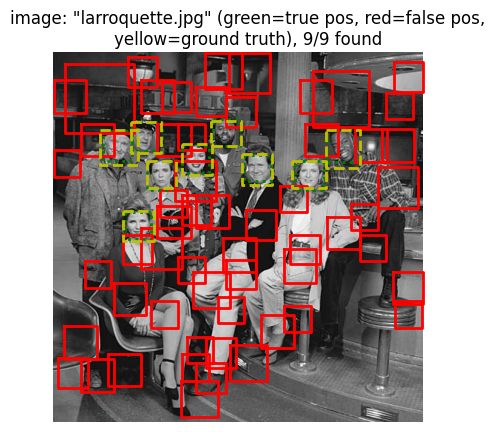

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


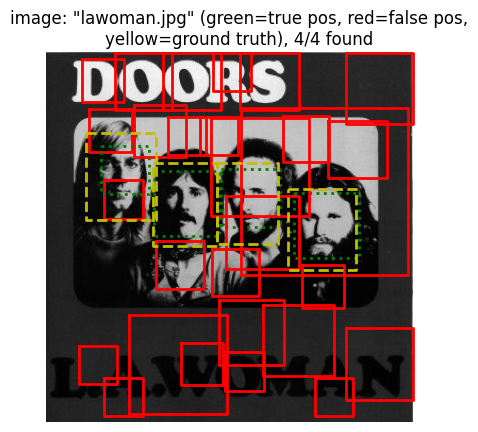

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


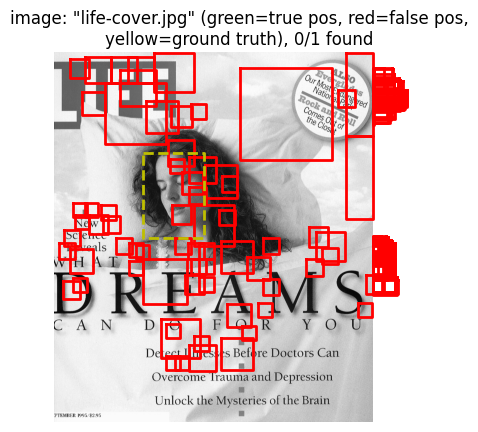

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


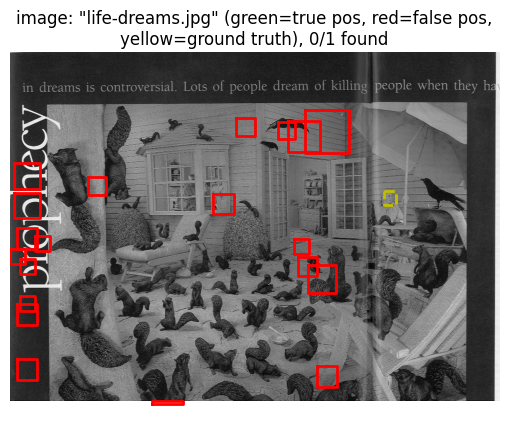

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


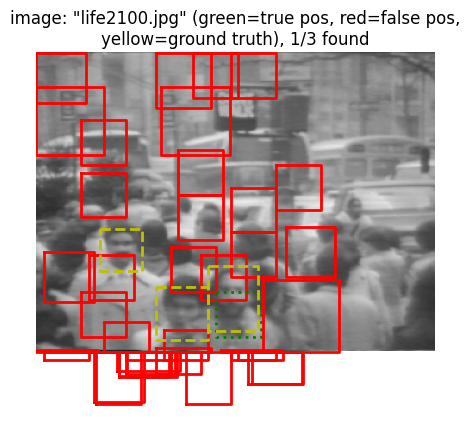

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


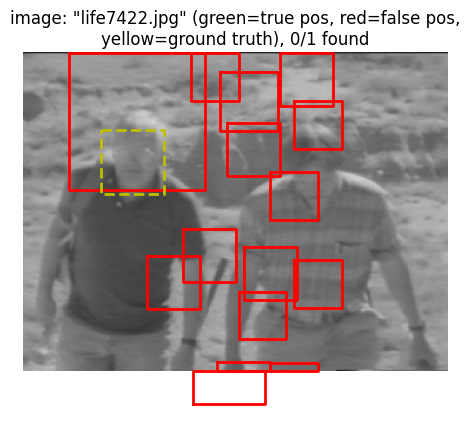

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


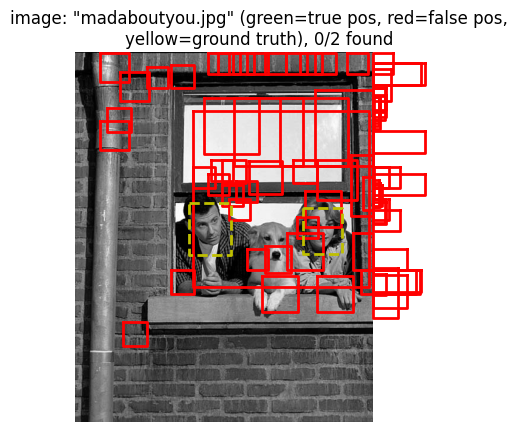

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


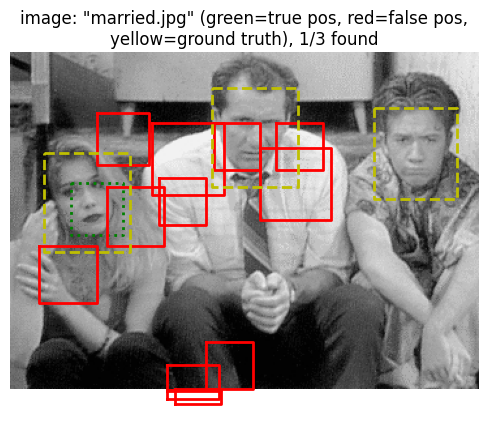

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


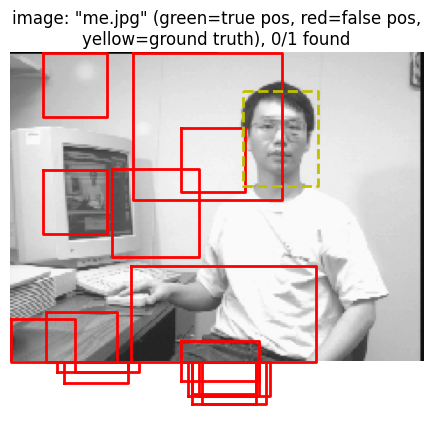

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


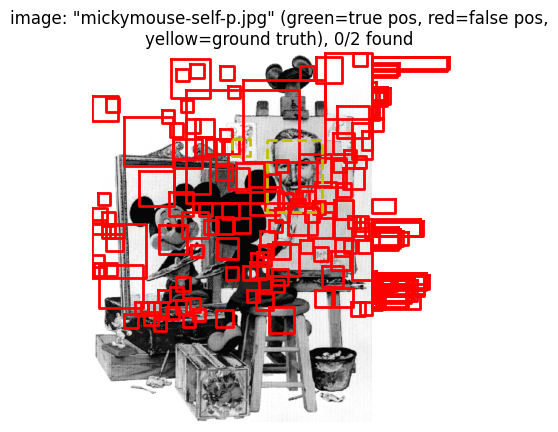

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


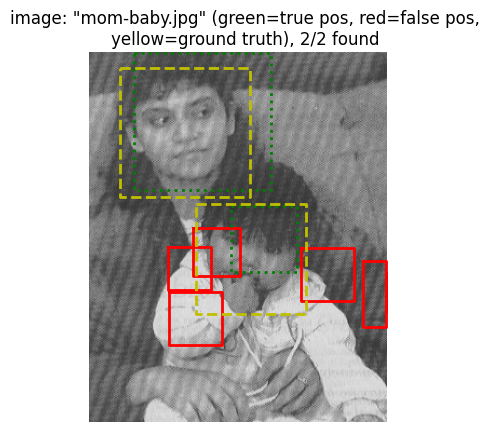

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


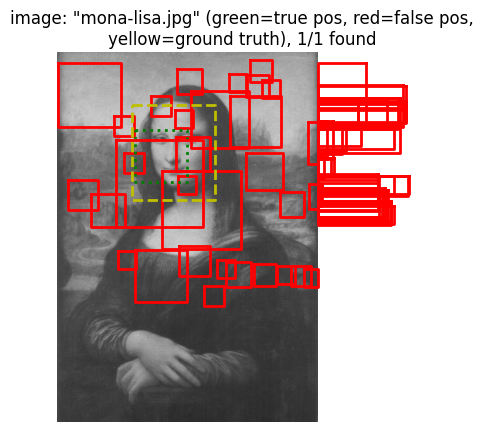

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


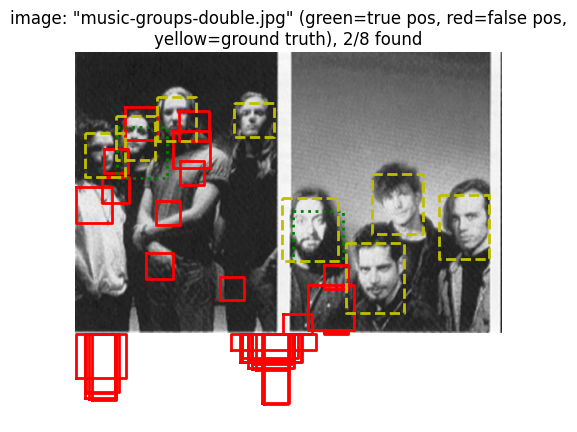

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


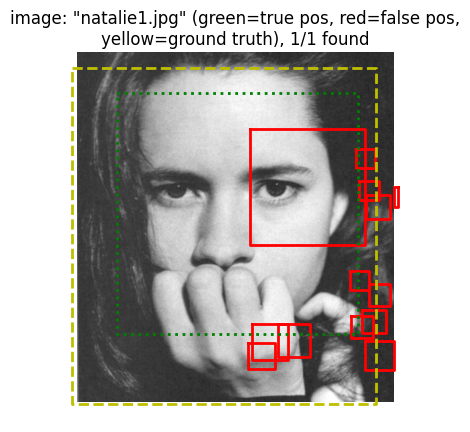

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


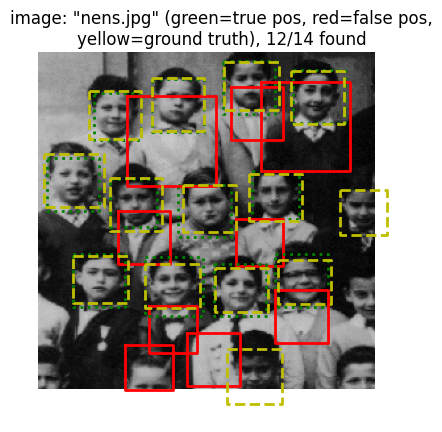

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


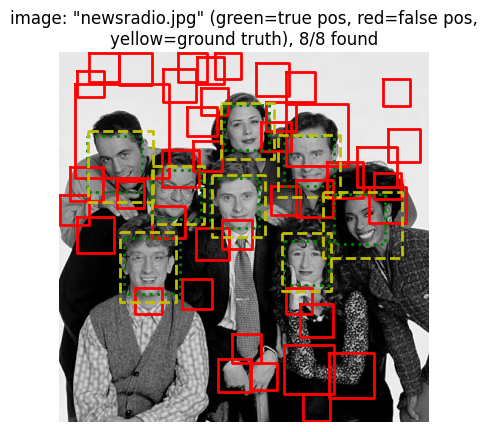

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


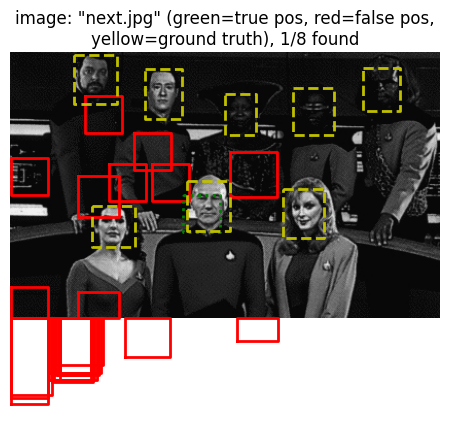

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


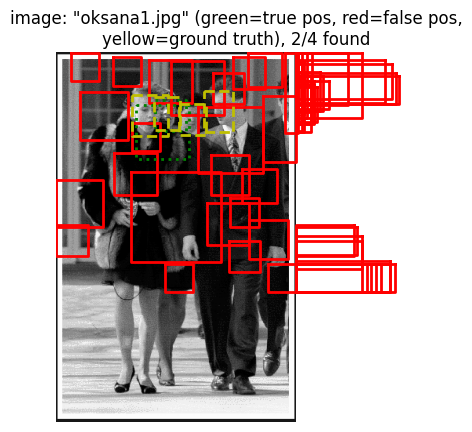

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


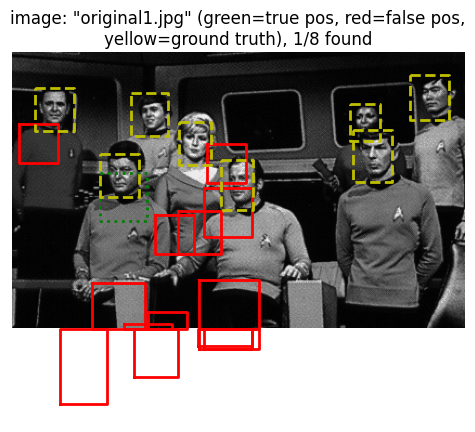

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


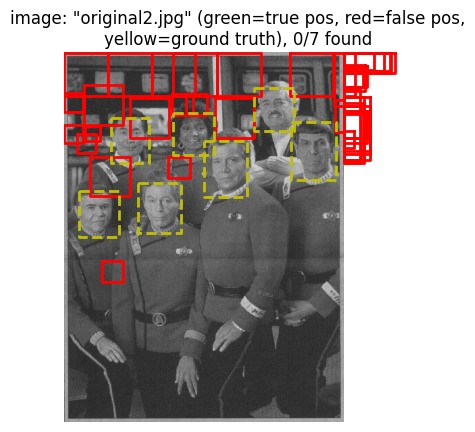

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


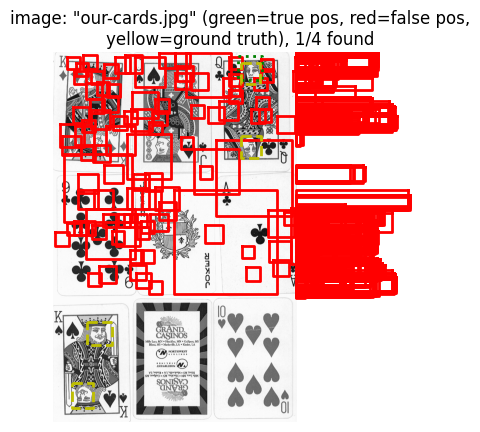

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


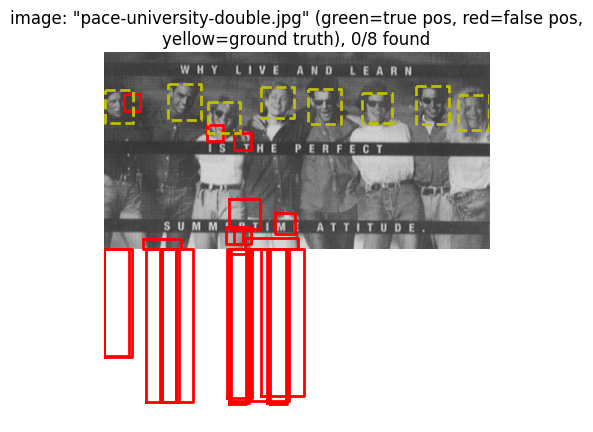

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


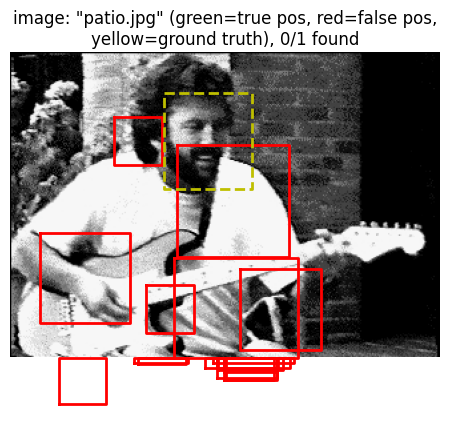

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


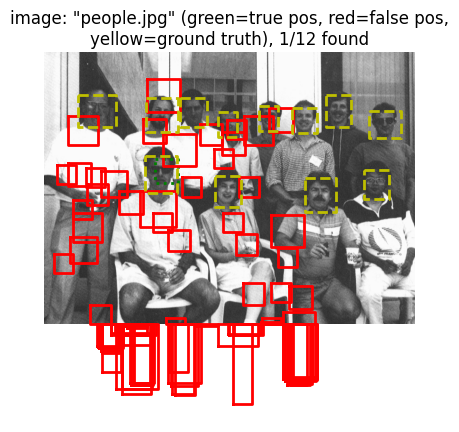

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


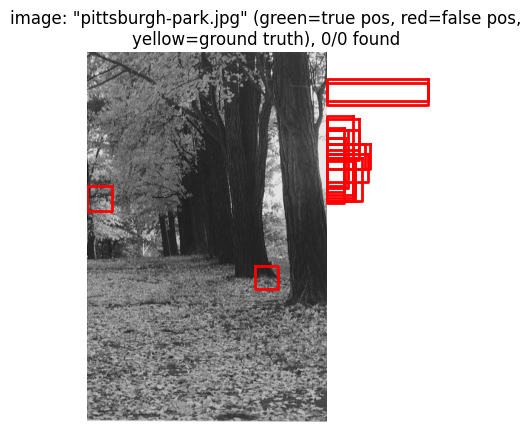

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


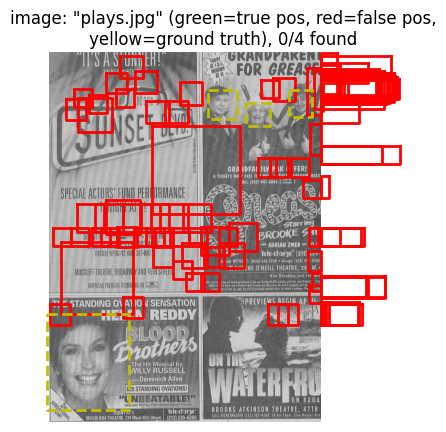

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


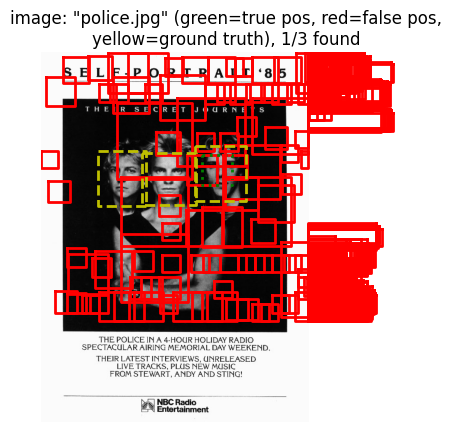

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


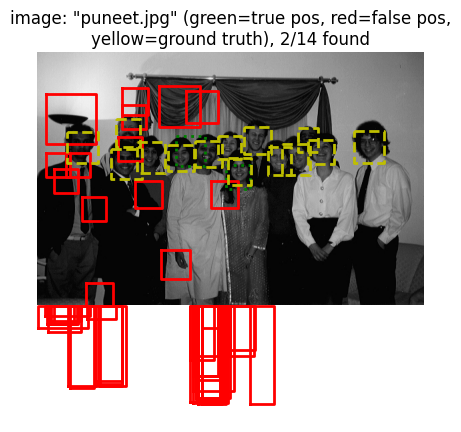

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


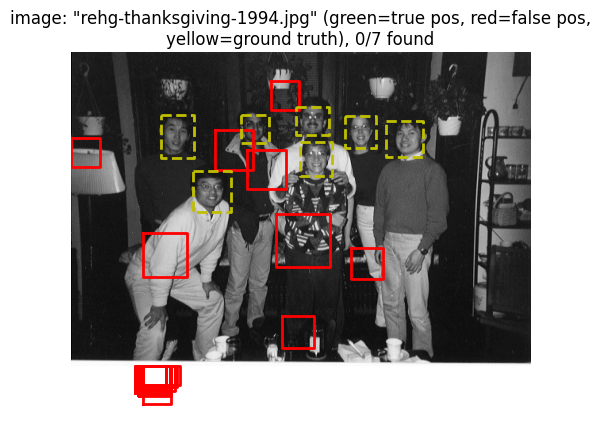

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


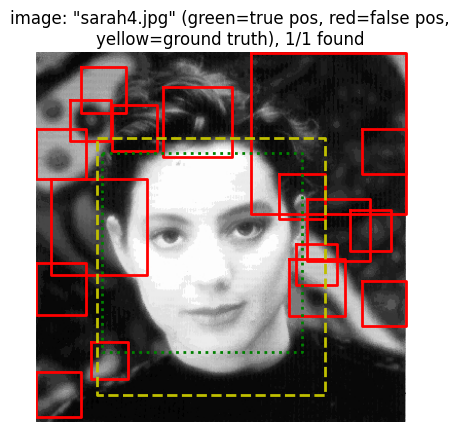

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


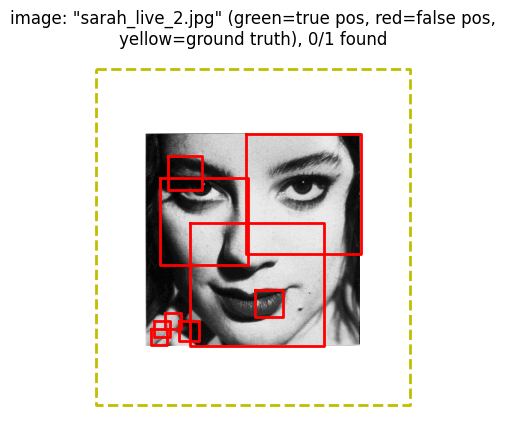

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


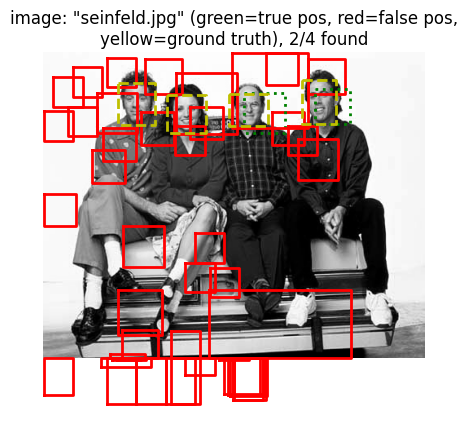

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


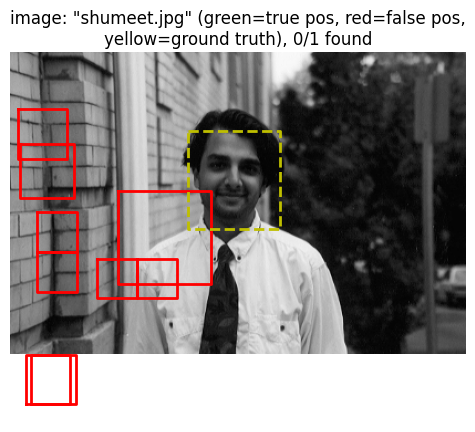

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


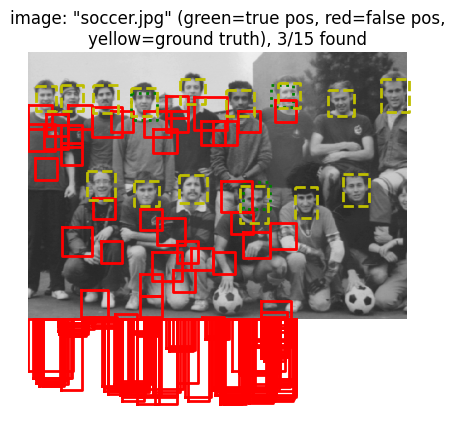

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


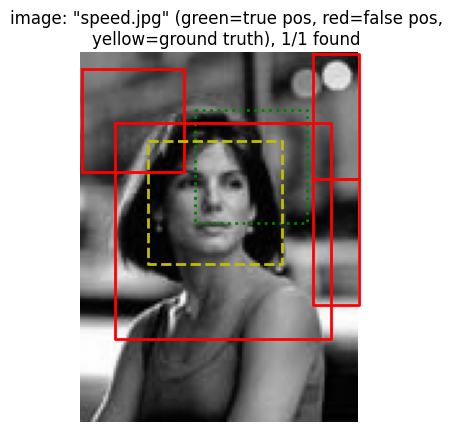

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


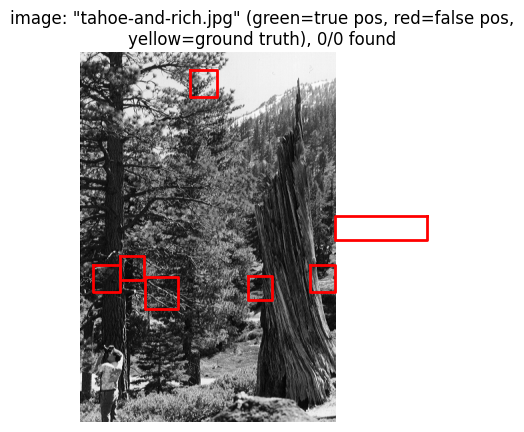

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


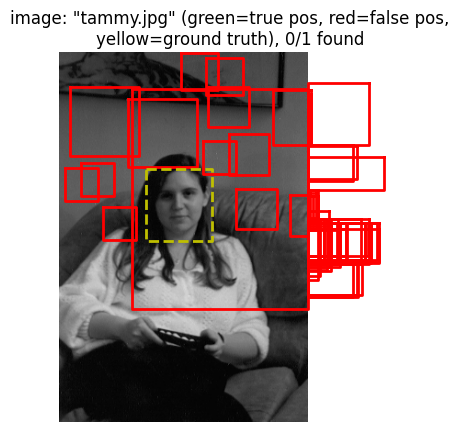

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


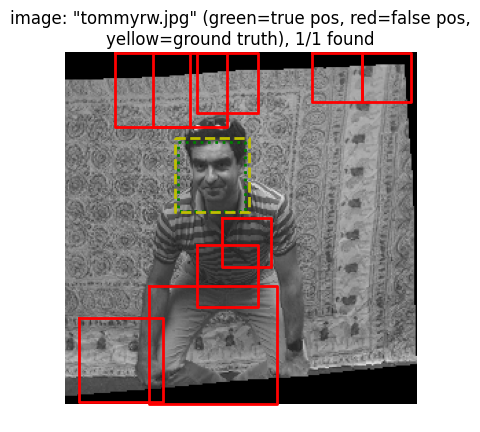

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


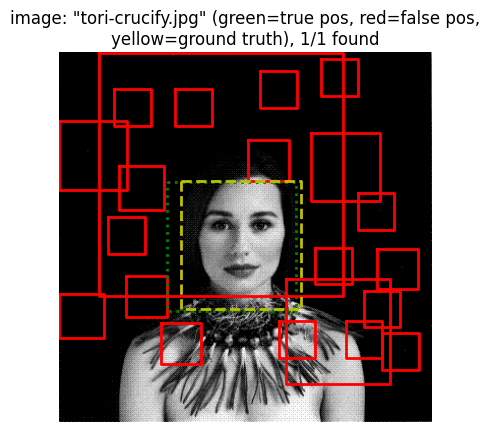

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


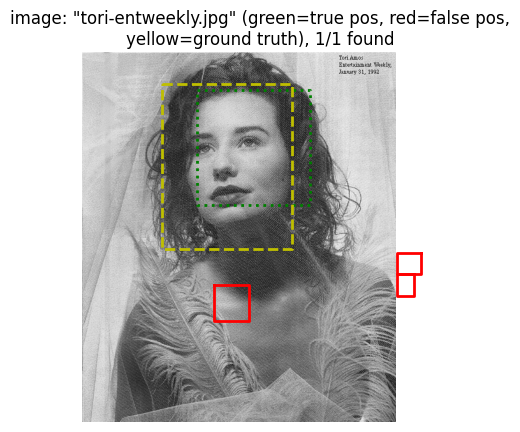

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


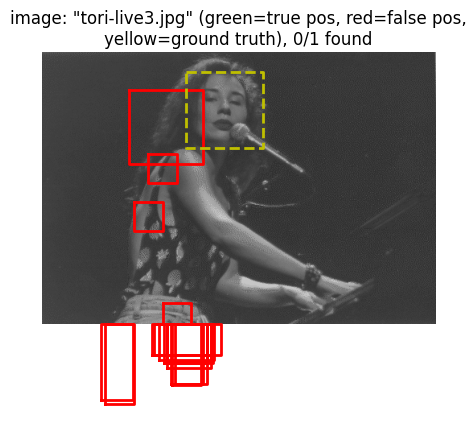

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


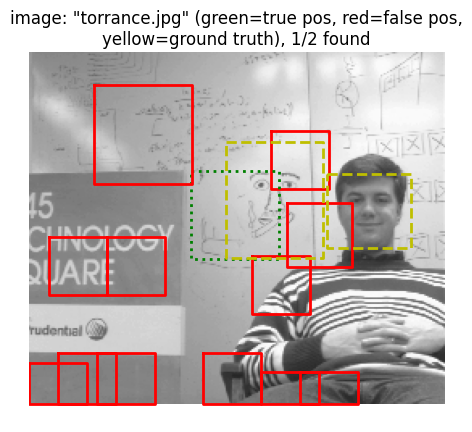

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


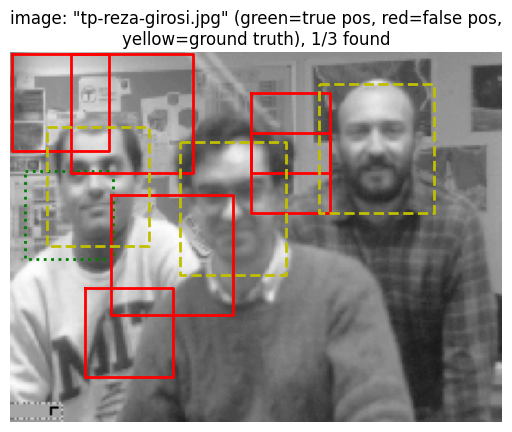

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


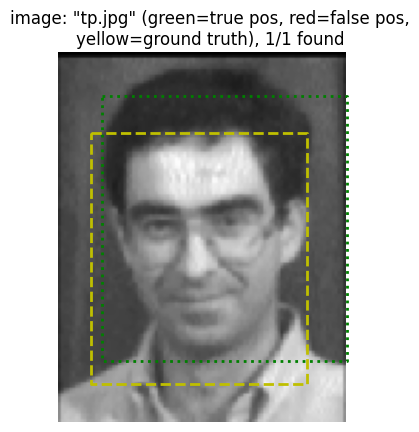

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


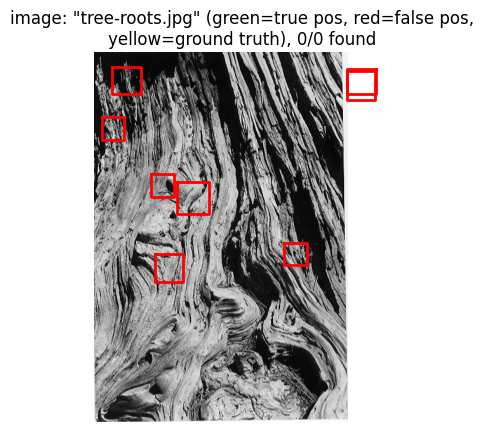

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


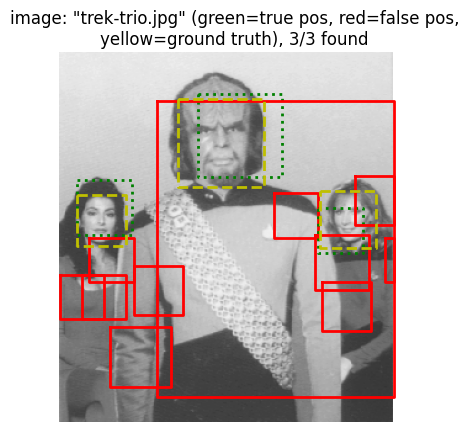

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


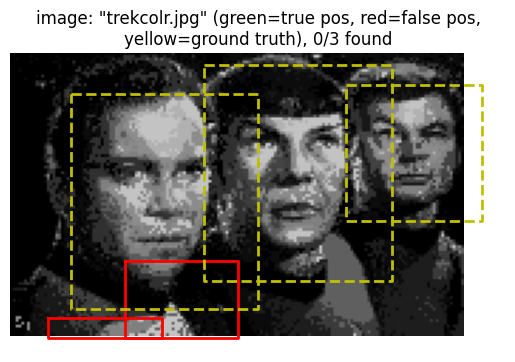

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


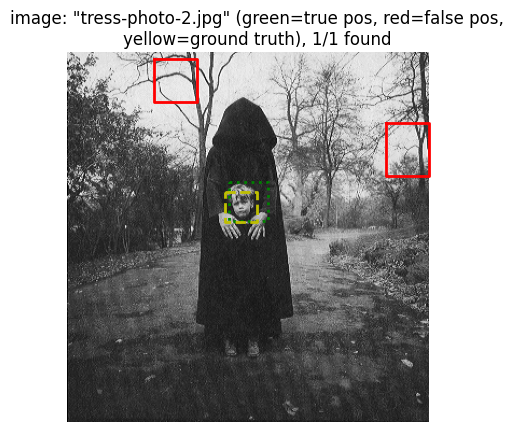

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


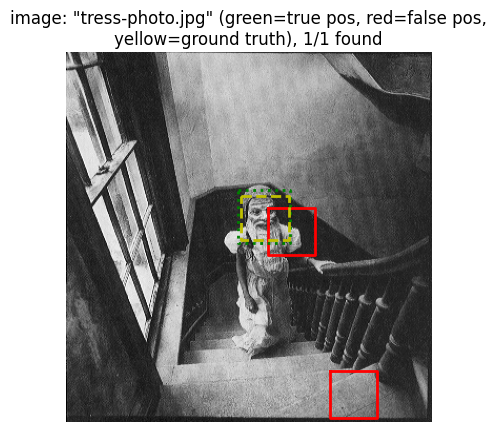

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


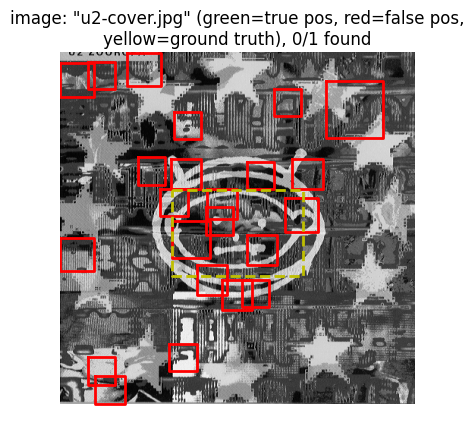

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


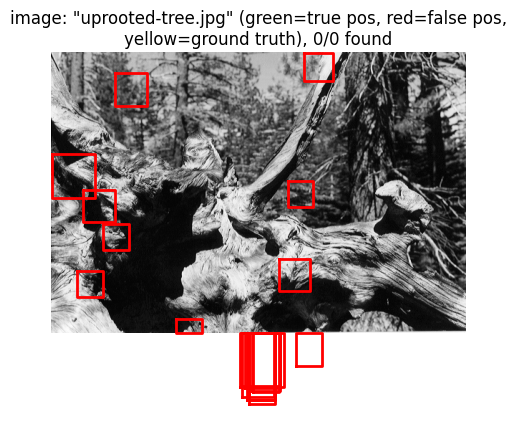

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


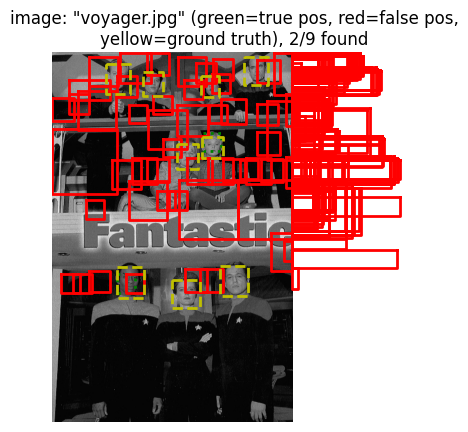

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


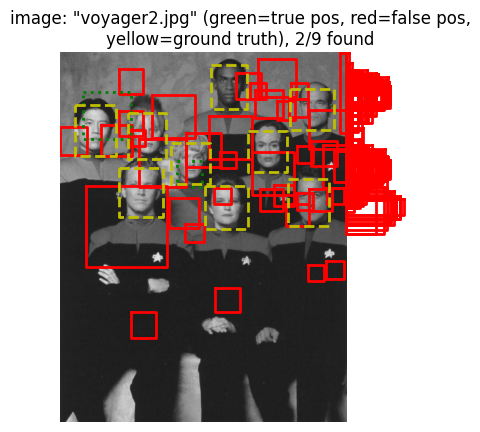

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


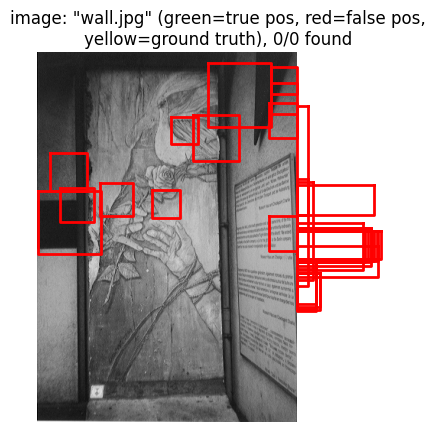

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


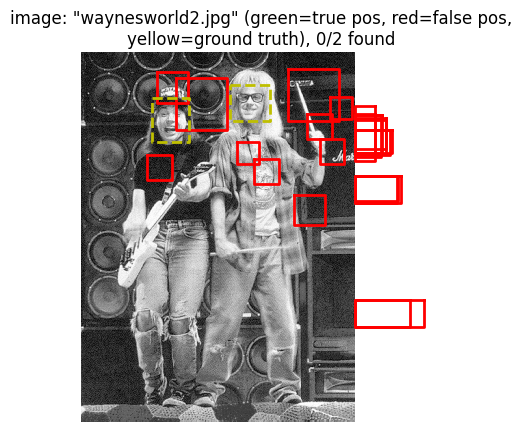

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


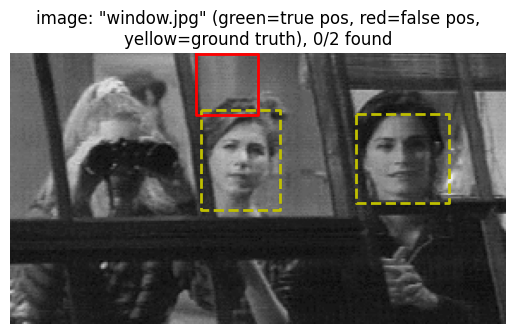

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


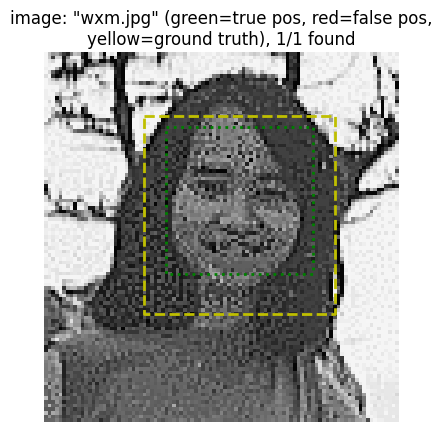

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


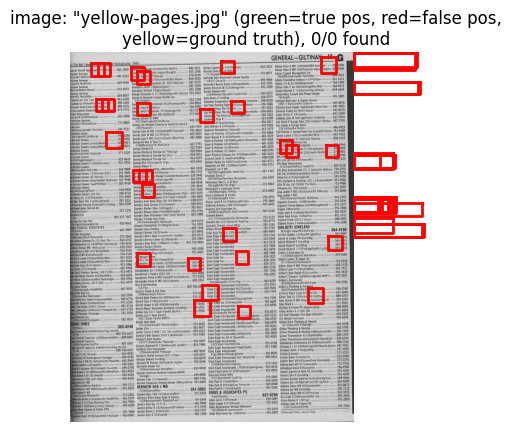

/tmp/ipykernel_2867/3322176410.py:78: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cur_image_id, np.sum(cur_tp, dtype=np.int), len(cur_gt_bboxes), 'interpreter', 'none'))


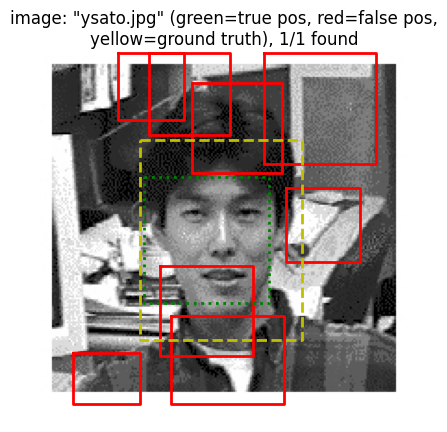

In [66]:
# Sliding window face detection with linear SVM
import numpy as np
import os
import pdb
from cyvlfeat.hog import hog
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from skimage import draw, exposure


def main():
    # root directory of all data
    data_path = 'data/'

    # directory of positive training examples. 36x36 head crops
    train_path_pos = os.path.join(data_path, 'caltech_faces/Caltech_CropFaces')

    # print(train_path_pos)
    # we can mine random or hard negatives from here
    non_face_scn_path = os.path.join(data_path, 'train_non_face_scenes')

    # CMU+MIT test scenes
    test_scn_path = os.path.join(data_path, 'test_scenes/test_jpg')

    # the ground truth face locations in the test set
    label_path = os.path.join(data_path, 'test_scenes/ground_truth_bboxes.txt')

    # directory for saving figure
    fig_path = 'visualizations'
    if not os.path.exists(fig_path):
        os.mkdir(fig_path)

    # The faces are 36x36 pixels, which works fine as a template size. You could
    # add other fields to this struct if you want to modify HoG default
    # parameters such as the number of orientations, but that does not help
    # performance in our limited test.
    feature_params = {'template_size': 36,
                      'hog_cell_size': 6}

    ## Step 1. Load positive training crops and random negative examples
    # YOU CODE 'get_positive_features' and 'get_random_negative_features'
    features_pos = get_positive_features(train_path_pos, feature_params)


    # higher will work strictly better, but your should start with 10000
    num_negative_examples = 10000
    features_neg, neg_examples = get_random_negative_features(non_face_scn_path, feature_params, num_negative_examples)

    ## Step 2. Train classifier
    features_total = np.concatenate([features_pos,features_neg], axis=0)
    labels = np.concatenate([np.ones((features_pos.shape[0], 1)), -np.ones((features_neg.shape[0], 1))],
                            axis=0)

    model = svm_classify(features_total, labels)

    ## Step 3. Examine learned classifier
    # You don't need to modify anything in this section. The section first
    # evaluates _training_ error, which isn't ultimately what we care about,
    # but it is a good sanity check. Your training error should be very low.
    print('Initial classifier performance on train data:')
    confidences = model.decision_function(features_total)
    label_vector = labels
    tp_rate, fp_rate, tn_rate, fn_rate = report_accuracy(confidences, label_vector)


    # Visualize how well separated the positive and negative examples are at
    # training time. Sometimes this can idenfity odd biases in your training
    # data, especially if you're trying hard negative mining. This
    # visualization won't be very meaningful with the placeholder starter code.
    non_face_confs = confidences[label_vector.ravel()<0]
    face_confs = confidences[label_vector.ravel()>0]
    fig2 = plt.figure(2)
    # plt.hold(True)
    plt.plot(np.arange(non_face_confs.size), np.sort(non_face_confs), color='g')
    plt.plot(np.arange(face_confs.size), np.sort(face_confs), color='r')
    plt.plot([0, non_face_confs.size], [0,0], color='b')
    # plt.hold(False)

    ## Step 4. (optional) Mine hard negatives
    # Mining hard negatives is extra credit. You can get very good performance
    # by using random negatives, so hard negative mining is somewhat
    # unnecessary for face detection. If you implement hard negative mining,
    # you probably want to modify 'run_detector', run the detector on the
    # images in 'non_face_scn_path', and keep all of the features above some
    # confidence level.

    # hard negative mining

    # hard positive mining

    # training with hard examples

    # estimate again after hard example mining

    # visualize

    ## Step 5. Run detector on test set.
    # YOU CODE 'run_detector'. Make sure the outputs are properly structured!
    # They will be interpreted in Step 6 to evaluate and visualize your
    # results. See run_detector.m for more details.
    bboxes, confidences, image_ids = run_detector(test_scn_path, model, feature_params)

    # run_detector will have (at least) two parameters which can heavily
    # influence performance -- how much to rescale each step of your multiscale
    # detector, and the threshold for a detection. If your recall rate is low
    # and your detector still has high precision at its highest recall point,
    # you can improve your average precision by reducing the threshold for a
    # positive detection.


    ## Step 6. Evaluate and Visualize detections
    # These functions require ground truth annotations, and thus can only be
    # run on the CMU+MIT face test set. Use visualize_detectoins_by_image_no_gt
    # for testing on extra images (it is commented out below).

    # Don't modify anything in 'evaluate_detections'
    gt_ids, gt_bboxes, gt_isclaimed, tp, fp, duplicate_detections = \
        evaluate_detections(bboxes, confidences, image_ids, label_path, fig_path)

    visualize_detections_by_image(bboxes, confidences, image_ids, tp, fp, test_scn_path, label_path, fig_path)

    # performance to aim for
    # random (stater code) 0.001 AP
    # single scale ~ 0.2 to 0.4 AP
    # multiscale, 6 pixel step ~ 0.83 AP
    # multiscale, 4 pixel step ~ 0.89 AP
    # multiscale, 3 pixel step ~ 0.92 AP

if __name__=="__main__":
    main()